In [1]:
import sys
import os
sys.path.append('/root/capsule/code/beh_ephys_analysis')
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import pandas as pd
from pynwb import NWBFile, TimeSeries, NWBHDF5IO
from scipy.io import loadmat
from scipy.stats import zscore
import ast
from pathlib import Path
import glob
import json
import seaborn as sns
from PyPDF2 import PdfMerger
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import re
from utils.beh_functions import session_dirs, parseSessionID, load_model_dv, makeSessionDF, get_session_tbl, get_unit_tbl, get_history_from_nwb
from utils.ephys_functions import*
from utils.ccf_utils import ccf_pts_convert_to_mm, pir_to_lps
from utils.combine_tools import apply_qc
import pickle
import scipy.stats as stats
import spikeinterface as si
import shutil
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.metrics import r2_score
import warnings
from scipy.stats import gaussian_kde
warnings.filterwarnings('ignore')
from matplotlib import colors as mcolors
from matplotlib import cm
import matplotlib.colors as mcolors
from sklearn.decomposition import PCA
from scipy.stats import zscore
from scipy.stats import ttest_ind
from sklearn.cross_decomposition import CCA
from trimesh import load_mesh
from scipy.stats import pearsonr
from aind_ephys_utils import align
import k3d
from joblib import Parallel, delayed
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.mixture import GaussianMixture

%matplotlib inline

# Load criteria and data

In [2]:
criteria_name = 'basic_ephys_low'

In [3]:
# load constraints and data
with open(os.path.join('/root/capsule/scratch/combined/combine_unit_tbl', 'combined_unit_tbl.pkl'), 'rb') as f:
    combined_tagged_units = pickle.load(f)
    
with open(os.path.join('/root/capsule/code/beh_ephys_analysis/session_combine/metrics', f'{criteria_name}.json'), 'r') as f:
    constraints = json.load(f)
beh_folder = os.path.join('/root/capsule/scratch/combined/beh_plots', criteria_name)
if not os.path.exists(beh_folder):
    os.makedirs(beh_folder)
# start with a mask of all True
mask = pd.Series(True, index=combined_tagged_units.index)

Applying bounds for isi_violations: [0.0, 0.5]
 - isi_violations: 18300 -> 11635 units passed
Applying items for qc_pass: [True]
 - qc_pass: 11635 -> 8492 units passed
Applying bounds for peak: [-1000, 500]
 - peak: 8492 -> 8456 units passed
Applying conditional bounds for y_loc
 - y_loc: 8456 -> 6252 units passed
Applying opto conditions: ['p_max', 'eu', 'corr', 'tag_loc', 'lat_max_p', 'p_mean', 'sig_counts']
Number of opto units after filtering: 725
Number of non-opto units after filtering: 6252


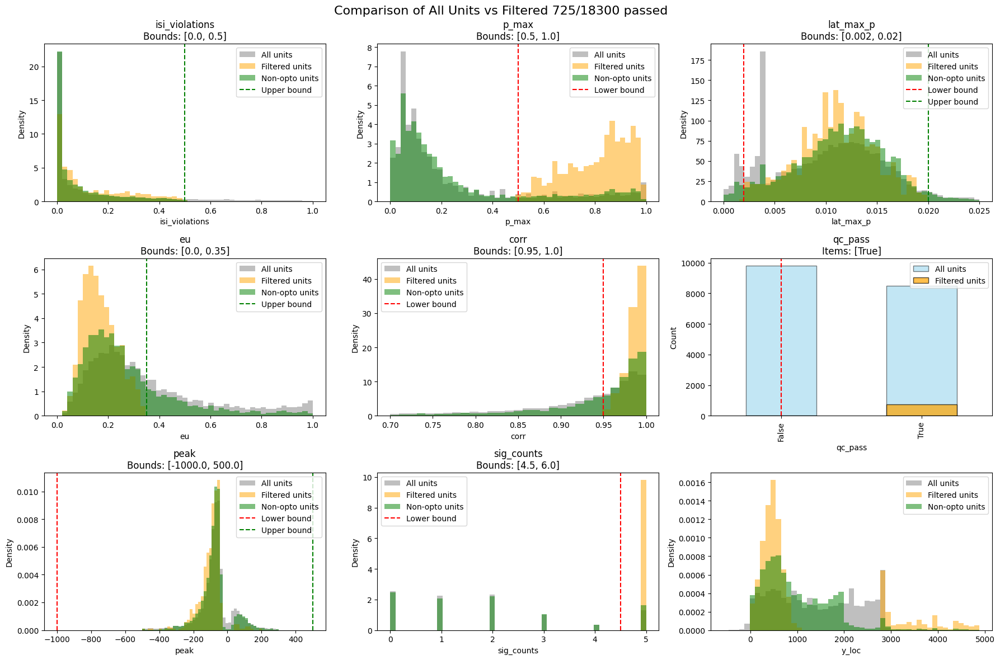

In [4]:
combined_tagged_units_filtered, combined_tagged_units, fig = apply_qc(combined_tagged_units, constraints)

# Calculate basic ephys features

## basic info

In [5]:
# functions
def correlate_nan(x, y, lag='full'):
    """Calculate correlation while ignoring NaNs."""
    if lag == 'full':
        lag = len(x) - 1
    corrs = np.full((lag + 1,), np.nan)
    for l in range(lag + 1):
        if l==0:
            valid_mask = ~np.isnan(x) & ~np.isnan(y)
            corrs[l] = np.corrcoef(x[valid_mask], y[valid_mask])[0, 1]
        else:
            valid_mask = ~np.isnan(x[:-l]) & ~np.isnan(y[l:])
            if np.any(valid_mask):
                corrs[l] = np.corrcoef(x[:-l][valid_mask], y[l:][valid_mask])[0, 1]
    return corrs

def autocorrelation(x, lag):
    n = len(x)
    x = x - np.nanmean(x)
    # result = np.correlate(x, x, mode='full')
    result = correlate_nan(x, x, lag = lag)  # only valid correlations
    # result = result[result.size // 2:]  # keep only second half
    # return result[:lag + 1] / result[0]  # normalize
    return result/result[0]  # normalize

def process(session, unit_id, in_df):
    if session.startswith('behavior_ZS'):
        in_df = True
    session_dir = session_dirs(session)
    unit_tbl = get_unit_tbl(session, data_type)
    drift_data = load_trial_drift(session, data_type)
    qm_dict_file = os.path.join(session_dir['processed_dir'], f'{session}_qm.json')
    with open(qm_dict_file, 'r') as f:
        qm_dict = json.load(f)
    rec_start = qm_dict['ephys_cut'][0]
    rec_end = qm_dict['ephys_cut'][1]
    opto_file = os.path.join(session_dir['opto_dir_curated'], 
                                f'{session}_opto_session.csv')
    if os.path.exists(opto_file):
        opto_tbl = pd.read_csv(opto_file)
        opto_times = opto_tbl['time'].values
    else:
        opto_times = np.array([])
    if in_df:
        session_df = makeSessionDF(session)
        session_df_go_cue = get_session_tbl(session)
        # session_df['ipsi'] = 2*(session_df['choice'].values - 0.5) * row['rec_side']
        in_df = True
    else:
        # if session_df exists, delete it to free memory
        if 'session_df' in locals():
            del session_df
            del session_df_go_cue
        in_df = False

    unit_drift = load_drift(session, unit_id, data_type=data_type)
    spike_times = unit_tbl.query('unit_id == @unit_id')['spike_times'].values[0]
    spike_times_curr = spike_times.copy()
    opto_times_curr = opto_times.copy()
    rec_start_curr = rec_start
    rec_end_curr = rec_end
    if unit_drift is not None:
        if unit_drift['ephys_cut'][0] is not None:
            spike_times_curr = spike_times_curr[spike_times_curr >= unit_drift['ephys_cut'][0]]
            rec_start_curr = unit_drift['ephys_cut'][0]
            opto_times_curr = opto_times_curr[opto_times_curr >= unit_drift['ephys_cut'][0]]
        if unit_drift['ephys_cut'][1] is not None:
            spike_times_curr = spike_times_curr[spike_times_curr <= unit_drift['ephys_cut'][1]]
            rec_end_curr = unit_drift['ephys_cut'][1]
            opto_times_curr = opto_times_curr[opto_times_curr <= unit_drift['ephys_cut'][1]]

    if in_df:
        session_df_curr = session_df.copy()
        session_df_go_cue_curr = session_df_go_cue.copy()
        # tblTrials_curr = tblTrials.copy()
        if unit_drift is not None:
            if unit_drift['ephys_cut'][0] is not None:
                spike_times_curr = spike_times_curr[spike_times_curr >= unit_drift['ephys_cut'][0]]
                session_df_curr = session_df_curr[session_df_curr['go_cue_time'] >= unit_drift['ephys_cut'][0]]
                session_df_go_cue_curr = session_df_go_cue_curr[session_df_go_cue_curr['goCue_start_time'] >= unit_drift['ephys_cut'][0]]
                # tblTrials_curr = tblTrials_curr[tblTrials_curr['goCue_start_time'] >= unit_drift['ephys_cut'][0]]
            if unit_drift['ephys_cut'][1] is not None:
                spike_times_curr = spike_times_curr[spike_times_curr <= unit_drift['ephys_cut'][1]]
                session_df_curr = session_df_curr[session_df_curr['go_cue_time'] <= unit_drift['ephys_cut'][1]]
                session_df_go_cue_curr = session_df_go_cue_curr[session_df_go_cue_curr['goCue_start_time'] <= unit_drift['ephys_cut'][1]]
                # tblTrials_curr = tblTrials_curr[tblTrials_curr['goCue_start_time'] <= unit_drift['ephys_cut'][1]]
        if len(session_df_curr) >2:
            # if session == 'behavior_716325_2024-05-31_10-31-14' and unit_id == 377:
            #     print('Fount it!')
            align_time_cue = session_df_go_cue_curr['goCue_start_time'].values
            align_time_cue_sham = np.random.uniform(np.min(align_time_cue), np.max(align_time_cue), size=max(len(align_time_cue), 20))
            align_time_response = session_df_curr['choice_time'].values
            # baseline
            baseline_df = align.to_events(spike_times_curr, align_time_cue, [-bl_len, -0.01], return_df=True)
            fr_bl = baseline_df.groupby('event_index').size()
            fr_bl = [fr_bl.get(i, 0) for i in range(len(session_df_go_cue_curr))]
            fr_bl = np.array(fr_bl, dtype=float)/bl_len
            fr_bl_mean = np.mean(fr_bl)

            baseline_df_sham = align.to_events(spike_times_curr, align_time_cue_sham, [-bl_len, -0.01], return_df=True)
            fr_bl_sham = baseline_df_sham.groupby('event_index').size()
            fr_bl_sham = [fr_bl_sham.get(i, 0) for i in range(len(session_df_go_cue_curr))]
            fr_bl_sham = np.array(fr_bl_sham, dtype=float)/bl_len
            fr_bl_sham_mean = np.mean(fr_bl_sham)
            # mean firing rate in baseline

            # response to go cue
            spike_matrix_response, slide_times = get_spike_matrix(spike_times_curr, align_time_cue, 
                                            pre_event=-0.5, post_event=1, 
                                            binSize=binSize, stepSize=0.1)
            spike_response_mean = np.mean(spike_matrix_response, axis=0)
            response_max_ind = np.argmax(spike_response_mean)
            # response = spike_matrix_response[:, response_max_ind]
        
            response = align.to_events(spike_times_curr, align_time_cue, [0.01, post_cue_len], return_df=True)
            response_sham = align.to_events(spike_times_curr, align_time_cue_sham, [0.01, post_cue_len], return_df=True)
            response_first= align.to_events(spike_times_curr, align_time_cue, [0, 1], return_df=True)
            response_first = response_first.groupby('event_index').min()
            response_first_lat = response_first.reindex(range(len(session_df_go_cue_curr)), fill_value=np.nan)['time'].values
            response_first_lat = np.array(response_first_lat, dtype=float)
            
            # for each trial find the first inter spike interval
            # and the mean of the first 2 intervals
            response_first_isi = []
            response_2_isi = []
            for ind_trial in range(len(response_first_lat)):
                curr_spike = response_first_lat[ind_trial] + align_time_cue[ind_trial]
                next_spike = spike_times_curr[spike_times_curr > curr_spike]
                if len(next_spike) > 0:
                    next_spike = next_spike[0]
                    isi_curr = next_spike - curr_spike
                else:
                    isi_curr = np.nan
                response_first_isi.append(isi_curr)

                next_2_spikes = spike_times_curr[(spike_times_curr >= curr_spike)]
                if len(next_2_spikes) > 2:
                    next_2_spikes = next_2_spikes[:3]
                    isi_curr_2 = np.mean(np.diff(next_2_spikes[:2]))
                else:
                    isi_curr_2 = np.nan
                response_2_isi.append(isi_curr_2)
            response_first_isi = np.array(response_first_isi, dtype=float)
            response_2_isi = np.array(response_2_isi, dtype=float)
            

            response = response.groupby('event_index').size()
            response = [response.get(i, 0) for i in range(len(session_df_go_cue_curr))]
            response = np.array(response, dtype=float)/post_cue_len

            response_sham = response_sham.groupby('event_index').size()
            response_sham = [response_sham.get(i, 0) for i in range(len(session_df_go_cue_curr))]
            response_sham = np.array(response_sham, dtype=float)/post_cue_len

            response_rate_all = (response - fr_bl) / fr_bl
            # print(f'Processing unit {unit_id} in session {session}')
            # print(f'{np.sum(np.isinf(response_rate_all))} out of {len(response_rate_all)} trials have inf')
            response_increase = response-fr_bl
            resposne_increase = np.nanmean(response_increase)
            response_rate_all[np.isinf(response_rate_all)] = np.nan

            mask = np.isnan(response) | np.isnan(fr_bl)
            curr_corr = np.corrcoef(response[~mask], fr_bl[~mask])[0, 1]
            mask_sham = np.isnan(response_sham) | np.isnan(fr_bl_sham)
            curr_corr_sham = np.corrcoef(response_sham[~mask_sham], fr_bl_sham[~mask_sham])[0, 1]
            # response_rate = np.nanmean(response_rate_all) # verions 1
            response_rate = (np.mean(response) - np.mean(fr_bl))/np.mean(fr_bl)  # version 2
            # ax = fig.add_subplot(gs[ind])
            # x = response_first_lat
            # y = response_2_isi
            # # ax.scatter(x, y, s=1, color='k', alpha=0.5)
            # ax.set_yscale('log')
            # nan_mask = np.isnan(x) | np.isnan(y)
            # coeff, p = pearsonr(x[~nan_mask], y[~nan_mask])
            # ax.set_title(f'p={p:.2f}')
            # if both sides more than 2
            if np.sum(session_df_go_cue_curr['animal_response'].values == 1) > 2 and \
            np.sum(session_df_go_cue_curr['animal_response'].values == 0) > 2:
                # response bias in right vs left
                response_bias = np.nanmean(response_rate_all[session_df_go_cue_curr['animal_response'].values == 1]) - \
                                np.nanmean(response_rate_all[session_df_go_cue_curr['animal_response'].values == 0])
            else:
                response_bias = np.nan
            # if both condition more than 2
            if np.sum(session_df_go_cue_curr['animal_response'].values != 2) > 2 and \
            np.sum(session_df_go_cue_curr['animal_response'].values == 2) > 2:
                # response bias in go vs no-go trials
                # response_diff = np.nanmean(response_rate_all[session_df_go_cue_curr['animal_response'].values != 2]) - \
                #                 np.nanmean(response_rate_all[session_df_go_cue_curr['animal_response'].values == 2]) # version 1
                go_inds = session_df_go_cue_curr['animal_response'].values != 2
                no_go_inds = session_df_go_cue_curr['animal_response'].values == 2
                response_diff = (np.mean(response[go_inds]) - np.mean(fr_bl[go_inds]))/np.mean(fr_bl[go_inds]) - \
                                (np.mean(response[no_go_inds]) - np.mean(fr_bl[no_go_inds]))/np.mean(fr_bl[no_go_inds]) # version 2
                response_go = np.nanmean(response_rate_all[session_df_go_cue_curr['animal_response'].values != 2])
                response_no_go = np.nanmean(response_rate_all[session_df_go_cue_curr['animal_response'].values == 2])
                # bl_bias in go vs no-go
                bl_diff = (np.nanmean(fr_bl[session_df_go_cue_curr['animal_response'].values != 2]) - \
                                np.nanmean(fr_bl[session_df_go_cue_curr['animal_response'].values == 2]))/np.mean(fr_bl)
                bl_go = np.nanmean(fr_bl[session_df_go_cue_curr['animal_response'].values != 2])
                bl_no_go = np.nanmean(fr_bl[session_df_go_cue_curr['animal_response'].values == 2])

            else:
                response_diff = np.nan
                bl_diff = np.nan
                response_no_go = np.nan
                response_go = np.nan
                bl_go = np.nan
                bl_no_go = np.nan
                response_first_lat = np.nan
                response_2_isi = np.nan
            # if both reward and no reward trials more than 2
            if np.sum(session_df_curr['outcome'].values == 1) > 2 and \
            np.sum(session_df_curr['outcome'].values == 0) > 2:
                # reward vs no-reward
                reward_delay = np.mean(session_df_go_cue_curr['reward_delay'].values)

                spike_matrix_reward, slide_times = get_spike_matrix(spike_times_curr, align_time_response+reward_delay, 
                                                            pre_event=-0.3, post_event=post_event, 
                                                            binSize=1, stepSize=0.25)
                spike_reward_mean = np.mean(spike_matrix_reward[session_df_curr['outcome']==1], axis=0)
                spike_noreward_mean = np.mean(spike_matrix_reward[session_df_curr['outcome']==0], axis=0)
                max_win_ind = np.argmax(np.abs(spike_reward_mean - spike_noreward_mean))
                spike_reward_peak_mean = np.mean(spike_matrix_reward[session_df_curr['outcome']==1][:, max_win_ind])
                spike_noreward_peak_mean = np.mean(spike_matrix_reward[session_df_curr['outcome']==0][:, max_win_ind])
                outcome_diff = (spike_reward_peak_mean - spike_noreward_peak_mean) / np.mean(fr_bl)
                outcome_diff_abs = np.abs(outcome_diff)
            else:
                outcome_diff = np.nan
                outcome_diff_abs = np.nan
        else: # too short session
            if len(opto_times_curr) > 1:
                baseline_df = align.to_events(spike_times_curr, opto_times_curr, [-bl_len, -0.01], return_df=True)
                fr_bl = baseline_df.groupby('event_index').size()
                fr_bl = [fr_bl.get(i, 0) for i in range(len(opto_times_curr))]
                fr_bl = np.array(fr_bl, dtype=float)
                fr_bl_mean = np.mean(fr_bl)/bl_len
            else: # if too few trials
                fr_bl_mean = np.shape(spike_times_curr)[0] / (rec_end_curr - rec_start_curr)

            response_rate = np.nan
            response_increase = np.nan
            response_bias = np.nan
            response_diff = np.nan
            response_first_lat = np.nan
            response_2_isi = np.nan
            bl_diff = np.nan
            outcome_diff = np.nan
            outcome_diff_abs = np.nan
            curr_curr = np.nan
            curr_corr_sham = np.nan
            response_go = np.nan
            response_no_go = np.nan
            bl_go = np.nan
            bl_no_go = np.nan
    else:
        # if not in_df, we cannot compute the response rate or bias
        # remove opto stimulation times
        if len(opto_times_curr) > 1:
            baseline_df = align.to_events(spike_times_curr, opto_times_curr, [-bl_len, -0.01], return_df=True)
            fr_bl = baseline_df.groupby('event_index').size()
            fr_bl = [fr_bl.get(i, 0) for i in range(len(opto_times_curr))]
            fr_bl = np.array(fr_bl, dtype=float)
            fr_bl_mean = np.mean(fr_bl)/bl_len
        else:
            fr_bl_mean = np.shape(spike_times_curr)[0] / (rec_end_curr - rec_start_curr)
        
        response_rate = np.nan
        response_increase = np.nan
        response_bias = np.nan
        response_diff = np.nan
        response_first_lat = np.nan
        response_2_isi = np.nan
        bl_diff = np.nan
        outcome_diff = np.nan
        outcome_diff_abs = np.nan
        curr_corr = np.nan
        curr_corr_sham = np.nan
        response_go = np.nan
        response_no_go = np.nan
        bl_go = np.nan
        bl_no_go = np.nan
    return {'session': session,
            'unit_id': unit_id,
            'bl_mean': fr_bl_mean,
            'response_rate': response_rate,
            'response_bias': response_bias,
            'response_diff': response_diff,
            'bl_diff': bl_diff,
            'outcome_diff': outcome_diff,
            'outcome_diff_abs': outcome_diff_abs,
            'bl_response_corr': curr_corr,
            'bl_response_corr_sham': curr_corr_sham,
            'go_mean': bl_go,
            'no_go_mean': bl_no_go,
            'response_lat': response_first_lat,
            'response_isi': response_2_isi
            }

In [6]:
# get all t-stats, coeffs, p-values for the two groups
# grab all tagged units and combine spike waveforms
data_type = 'curated'
target = 'soma'

pre_event = -1.5
post_event = 3
binSize = 0.5
bl_len = 2
post_cue_len = 0.3

auto_inhi_bin = 0.2
window_length = 2


In [7]:
all_results = []
def safe_process(row):
    """Wrapper to safely call process() and catch errors."""
    try:
        return process(row['session'], row['unit'], row['in_df'])
    except Exception as e:
        print(f"[Error] session {row['session']}, unit {row['unit']}: {e}")
        return {'session': row['session'],
                'unit_id': row['unit'],
                'bl_mean': np.nan,
                'response_rate': np.nan,
                'response_bias': np.nan,
                'response_diff': np.nan,
                'bl_diff': np.nan,
                'outcome_diff': np.nan,
                'outcome_diff_abs': np.nan,
                'bl_response_corr': np.nan,
                'bl_response_corr_sham': np.nan,
                'go_mean': np.nan,
                'no_go_mean': np.nan,
                'response_lat': np.nan,
                'response_isi': np.nan,
                }

# for ind, row in combined_tagged_units_filtered.iterrows():
#     session = row['session']
#     unit_id = row['unit']
#     # check if different session
#     result = process(session, unit_id)
#     all_results.append(result)

results = Parallel(n_jobs=-1)(delayed(safe_process)(row) for ind, row in combined_tagged_units_filtered.iterrows())

/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: invalid

[Error] session behavior_758017_2025-02-04_11-57-38, unit 198: local variable 'curr_corr' referenced before assignment


/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide by zero encountered in divide
/tmp/ipykernel_3859670/578946544.py:155: RuntimeWarning: divide

In [8]:
basic_ephys_df = pd.DataFrame(results)
basic_ephys_df['bl_response_corr_diff'] = basic_ephys_df['bl_response_corr'] - basic_ephys_df['bl_response_corr_sham']

In [9]:
combined_tagged_units_filtered = combined_tagged_units_filtered.rename(columns={'unit':'unit_id'})

In [10]:
basic_ephys_df = basic_ephys_df.merge(combined_tagged_units_filtered[['session', 'unit_id', 'probe']], on=['session', 'unit_id'], how='left')

test plotting

(array([ 7.,  4., 39., 50., 45., 81., 84., 72., 47., 26., 22.,  6., 11.,
         5.,  3.,  3.,  1.,  1.,  1.,  2.]),
 array([-0.55185516, -0.48937451, -0.42689387, -0.36441322, -0.30193257,
        -0.23945193, -0.17697128, -0.11449063, -0.05200998,  0.01047066,
         0.07295131,  0.13543196,  0.1979126 ,  0.26039325,  0.3228739 ,
         0.38535455,  0.44783519,  0.51031584,  0.57279649,  0.63527713,
         0.69775778]),
 <BarContainer object of 20 artists>)

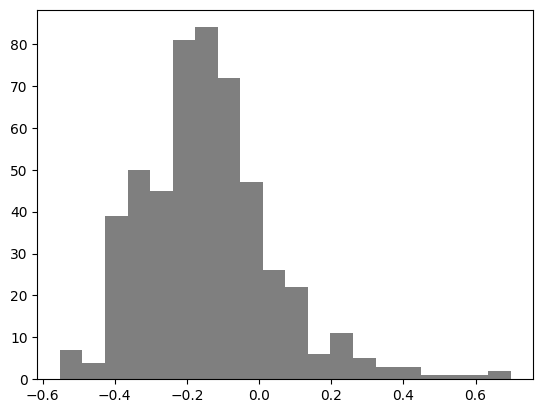

In [11]:
plt.hist(basic_ephys_df['bl_response_corr'], color='k', bins=20, alpha=0.5, label='bl_response_corr')

{'2': 0, 'opto': 1, 'tt': 2}


{'2': 0, 'opto': 1, 'tt': 2}

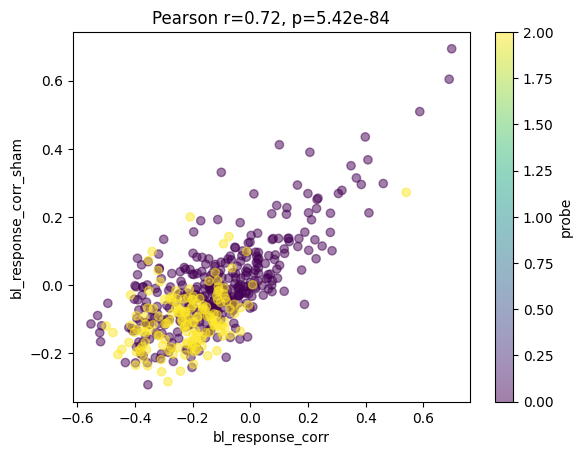

In [12]:
x_var = 'bl_response_corr'
y_var = 'bl_response_corr_sham'
hue = 'probe'
# deal with categorical hue
if basic_ephys_df[hue].dtype == 'object' or basic_ephys_df[hue].dtype.name == 'category':
    unique_categories = basic_ephys_df[hue].dropna().unique()
    category_to_num = {cat: i for i, cat in enumerate(unique_categories)}
    print(category_to_num)
    hue_all = basic_ephys_df[hue].map(category_to_num)
else:
    hue_all = basic_ephys_df[hue]
plt.scatter(basic_ephys_df[x_var], basic_ephys_df[y_var], c = hue_all, alpha=0.5)
# add color bar
cbar = plt.colorbar()
cbar.set_label(hue)
x = basic_ephys_df[x_var]
y = basic_ephys_df[y_var]
nan_mask = np.isnan(x) | np.isnan(y)
corr, p = pearsonr(x[~nan_mask], y[~nan_mask])
plt.xlabel(x_var)
plt.ylabel(y_var)
plt.title(f'Pearson r={corr:.2f}, p={p:.2e}')
category_to_num

Text(0.5, 0.98, 'Pearson r=-0.33, p=3.87e-14')

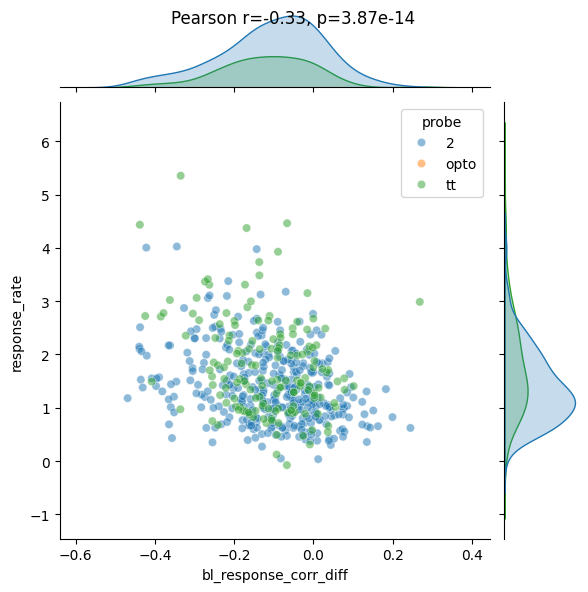

In [13]:
x_var = 'bl_response_corr_diff'
y_var = 'response_rate'
hue_var = 'probe'
sns.jointplot(data=basic_ephys_df, x=x_var, y=y_var, hue=hue_var, alpha=0.5)
# add correlation to title
x = basic_ephys_df[x_var]
y = basic_ephys_df[y_var]
nan_mask = np.isnan(x) | np.isnan(y)
corr, p = pearsonr(x[~nan_mask], y[~nan_mask])
plt.suptitle(f'Pearson r={corr:.2f}, p={p:.2e}')

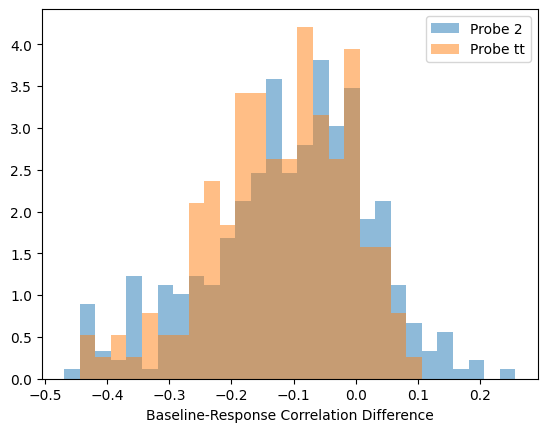

In [14]:
bl_response_corr_diff = basic_ephys_df['bl_response_corr'] - basic_ephys_df['bl_response_corr_sham']
probes = basic_ephys_df['probe'].unique()
edges = np.arange(np.nanmin(bl_response_corr_diff), np.nanmax(bl_response_corr_diff), 0.025)
for probe in probes:
    probe_mask = basic_ephys_df['probe'] == probe
    data_probe = bl_response_corr_diff[probe_mask]
    if np.sum(~np.isnan(data_probe)) > 0:
        plt.hist(data_probe, bins=edges, alpha=0.5, label=f'Probe {probe}', density=True)
plt.xlabel('Baseline-Response Correlation Difference')
plt.legend()

T-statistic: 3.4585504009888552, P-value: 0.0006065102164017634, Degrees of freedom: 369.0


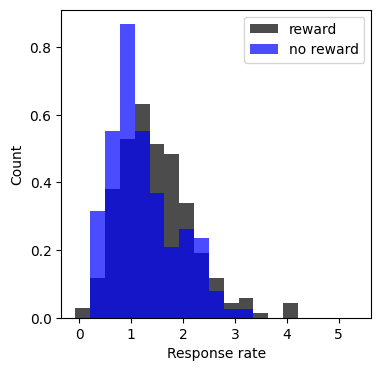

In [15]:
bins = np.linspace(basic_ephys_df['response_rate'].min(), basic_ephys_df['response_rate'].max(), 20)
plt.figure(figsize=(4, 4))
plt.hist(basic_ephys_df[(basic_ephys_df['outcome_diff']>0)]['response_rate'], bins=bins, alpha=0.7, color='k', label='reward', density=True)
plt.hist(basic_ephys_df[(basic_ephys_df['outcome_diff']<0)]['response_rate'], bins=bins, alpha=0.7, color='b', label='no reward', density=True)
plt.xlabel('Response rate')
plt.ylabel('Count')
plt.legend()
# tstats
from statsmodels.stats.weightstats import ttest_ind
reward_response = basic_ephys_df[basic_ephys_df['outcome_diff']>0]['response_rate']
no_reward_response = basic_ephys_df[basic_ephys_df['outcome_diff']<0]['response_rate']
t_stat, p_value, df = ttest_ind(reward_response, no_reward_response, usevar='pooled')
print(f'T-statistic: {t_stat}, P-value: {p_value}, Degrees of freedom: {df}')

T-statistic: 0.8302431934281818, P-value: 0.40693812137447616, Degrees of freedom: 369.0


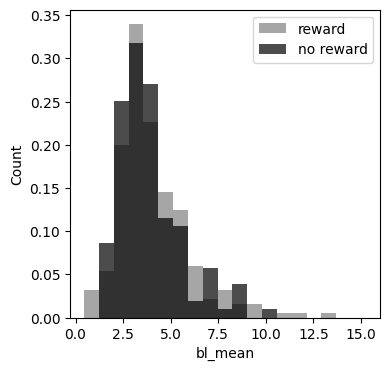

In [16]:
tar_var = 'bl_mean'
bins = np.linspace(basic_ephys_df[tar_var].min(), basic_ephys_df[tar_var].max(), 20)
plt.figure(figsize=(4, 4))
plt.hist(basic_ephys_df[basic_ephys_df['outcome_diff']>0][tar_var], bins=bins, alpha=0.7, color='gray', label='reward', density=True)
plt.hist(basic_ephys_df[basic_ephys_df['outcome_diff']<0][tar_var], bins=bins, alpha=0.7, color='k', label='no reward', density=True)
plt.xlabel(tar_var)
plt.ylabel('Count')
plt.legend()
# tstats
from statsmodels.stats.weightstats import ttest_ind
reward_response = basic_ephys_df[basic_ephys_df['outcome_diff']>0][tar_var]
no_reward_response = basic_ephys_df[basic_ephys_df['outcome_diff']<0][tar_var]
t_stat, p_value, df = ttest_ind(reward_response, no_reward_response, usevar='pooled')
print(f'T-statistic: {t_stat}, P-value: {p_value}, Degrees of freedom: {df}')

## ACF

In [17]:
def correlate_nan(x, y, lag='full'):
    """Calculate correlation while ignoring NaNs."""
    if lag == 'full':
        lag = len(x) - 1
    corrs = np.full((lag + 1,), np.nan)
    for l in range(lag + 1):
        if l==0:
            valid_mask = ~np.isnan(x) & ~np.isnan(y)
            corrs[l] = np.corrcoef(x[valid_mask], y[valid_mask])[0, 1]
        else:
            valid_mask = ~np.isnan(x[:-l]) & ~np.isnan(y[l:])
            if np.any(valid_mask):
                corrs[l] = np.corrcoef(x[:-l][valid_mask], y[l:][valid_mask])[0, 1]
    return corrs

def autocorrelation(x, lag):
    n = len(x)
    x = x - np.nanmean(x)
    # result = np.correlate(x, x, mode='full')
    result = correlate_nan(x, x, lag = lag)  # only valid correlations
    # result = result[result.size // 2:]  # keep only second half
    # return result[:lag + 1] / result[0]  # normalize
    return result/result[0]  # normalize

def auto_corr_train(spike_times, auto_inhi_bin, window_length, rec_start, rec_end):
    """
    Calculate autocorrelation of spike times.
    
    Parameters:
    spike_times : array-like
        Spike times of the unit.
    auto_inhi_bin : float
        Bin size for autocorrelation.
    window_length : float
        Length of the window for autocorrelation.
    rec_start : float
        Start time of the recording.
    rec_end : float
        End time of the recording.
        
    Returns:
    acf : array-like
        Autocorrelation function values.
    """
    counts = np.histogram(spike_times, bins=np.arange(rec_start, rec_end, auto_inhi_bin))[0]
    lag=int(window_length/auto_inhi_bin)
    n = len(counts)
    counts = counts - np.nanmean(counts)
    # result = np.correlate(x, x, mode='full')
    result = correlate_nan(counts, counts, lag = lag)  # only valid correlations
    return result/result[0]  # normalize

def process_acf(session, unit_id, in_df):
    if session.startswith('behavior_ZS'):
        in_df = True
    session_dir = session_dirs(session)
    unit_tbl = get_unit_tbl(session, data_type)
    drift_data = load_trial_drift(session, data_type)
    qm_dict_file = os.path.join(session_dir['processed_dir'], f'{session}_qm.json')
    with open(qm_dict_file, 'r') as f:
        qm_dict = json.load(f)
    rec_start = qm_dict['ephys_cut'][0]
    rec_end = qm_dict['ephys_cut'][1]
    opto_file = os.path.join(session_dir['opto_dir_curated'], 
                                f'{session}_opto_session.csv')
    if os.path.exists(opto_file):
        opto_tbl = pd.read_csv(opto_file)
        opto_times = opto_tbl['time'].values
    else:
        opto_times = np.array([])
    # opto_tbl = pd.read_csv(opto_file)
    # opto_times = opto_tbl['time'].values

    if in_df:
        session_df = makeSessionDF(session)
        session_df_go_cue = get_session_tbl(session)
        # session_df['ipsi'] = 2*(session_df['choice'].values - 0.5) * row['rec_side']
        in_df = True
    else:
        # if session_df exists, delete it to free memory
        if 'session_df' in locals():
            del session_df
            del session_df_go_cue
            del session_df_curr
        in_df = False

    unit_drift = load_drift(session, unit_id, data_type=data_type)
    qm_file = os.path.join(session_dir['processed_dir'], f'{session}_qm.json')
    with open(qm_file) as f:
        qm_dict = json.load(f)
    start_time = qm_dict['ephys_cut'][0]
    end_time = qm_dict['ephys_cut'][1]

    spike_times = unit_tbl.query('unit_id == @unit_id')['spike_times'].values[0]
    spike_times_curr = spike_times.copy()
    opto_times_curr = opto_times.copy()
    rec_start_curr = rec_start
    rec_end_curr = rec_end
    if unit_drift is not None:
        if unit_drift['ephys_cut'][0] is not None:
            spike_times_curr = spike_times_curr[spike_times_curr >= unit_drift['ephys_cut'][0]]
            rec_start_curr = unit_drift['ephys_cut'][0]
            opto_times_curr = opto_times_curr[opto_times_curr >= unit_drift['ephys_cut'][0]]
            start_time = unit_drift['ephys_cut'][0]
        if unit_drift['ephys_cut'][1] is not None:
            spike_times_curr = spike_times_curr[spike_times_curr <= unit_drift['ephys_cut'][1]]
            rec_end_curr = unit_drift['ephys_cut'][1]
            opto_times_curr = opto_times_curr[opto_times_curr <= unit_drift['ephys_cut'][1]]
            end_time = unit_drift['ephys_cut'][1]

    if unit_drift is not None:
        r2 = unit_drift['r_squared_slow_corrected']
        sd = unit_drift['sd/mean_updated']
        r2_ori = unit_drift['r_squared_slow']
        sd_ori = unit_drift['sd/mean']
    else:
        temp_bins = np.arange(start_time, end_time, bin_short)
        spike_counts_slow = np.full(len(temp_bins)-1, np.nan)
        for i in range(len(temp_bins)-1):
            bin_mask = (spike_times_curr >= temp_bins[i]-0.5*bin_long) & (spike_times_curr < temp_bins[i+1] + 0.5*bin_long)
            spike_counts_slow[i] = np.sum(bin_mask)/bin_long
        sd = np.std(spike_counts_slow[np.where(~np.isnan(spike_counts_slow))[0]])/np.nanmean(spike_counts_slow)
        r2 = 0
        r2_ori = 0
        sd_ori = sd

    if in_df:
        session_df_curr = session_df.copy()
        session_df_go_cue_curr = session_df_go_cue.copy()
        # tblTrials_curr = tblTrials.copy()
        if unit_drift is not None:
            if unit_drift['ephys_cut'][0] is not None:
                spike_times_curr = spike_times_curr[spike_times_curr >= unit_drift['ephys_cut'][0]]
                session_df_curr = session_df_curr[session_df_curr['go_cue_time'] >= unit_drift['ephys_cut'][0]]
                session_df_go_cue_curr = session_df_go_cue_curr[session_df_go_cue_curr['goCue_start_time'] >= unit_drift['ephys_cut'][0]]
                # tblTrials_curr = tblTrials_curr[tblTrials_curr['goCue_start_time'] >= unit_drift['ephys_cut'][0]]
            if unit_drift['ephys_cut'][1] is not None:
                spike_times_curr = spike_times_curr[spike_times_curr <= unit_drift['ephys_cut'][1]]
                session_df_curr = session_df_curr[session_df_curr['go_cue_time'] <= unit_drift['ephys_cut'][1]]
                session_df_go_cue_curr = session_df_go_cue_curr[session_df_go_cue_curr['goCue_start_time'] <= unit_drift['ephys_cut'][1]]
                # tblTrials_curr = tblTrials_curr[tblTrials_curr['goCue_start_time'] <= unit_drift['ephys_cut'][1]]
        # calculate auto-inhibition
        if len(session_df_go_cue_curr) > 0:
            session_start = session_df_go_cue_curr['goCue_start_time'].values[0]-10
            session_end = session_df_go_cue_curr['goCue_start_time'].values[-1]+20
            counts = np.histogram(spike_times_curr, bins=np.arange(session_start, session_end, auto_inhi_bin))[0]
            starts = np.arange(session_start, session_end, auto_inhi_bin)[:-1]
            ends = np.arange(session_start, session_end, auto_inhi_bin)[1:]
            
            # remove periods within session
            counts_bl = counts.copy().astype(float)
            if len(session_df_go_cue_curr) > 0:
                for ind, row in session_df_go_cue_curr.iterrows():
                    start_time = row['goCue_start_time'] - pre_time
                    end_time = row['goCue_start_time'] + post_time
                    # set counts in this period to np.nan
                    mask = (ends >= start_time) & (starts <= end_time)
                    if np.sum(mask) > 0:
                        counts_bl[mask] = np.nan
        else:
            counts = np.histogram(spike_times_curr, bins=np.arange(rec_start_curr, rec_end_curr, auto_inhi_bin))[0]
            starts = np.arange(rec_start_curr, rec_end_curr, auto_inhi_bin)[:-1]
            ends = np.arange(rec_start_curr, rec_end_curr, auto_inhi_bin)[1:]
            counts_bl = counts.copy().astype(float)
            for ind, row in enumerate((opto_times_curr)):
                start_time = row - pre_time
                end_time = row + 0.5*post_time
                # set counts in this period to np.nan
                mask = (ends >= start_time) & (starts <= end_time)
                if np.sum(mask) > 0:
                    counts_bl[mask] = np.nan
            
    else:
        counts = np.histogram(spike_times_curr, bins=np.arange(rec_start_curr, rec_end_curr, auto_inhi_bin))[0]
        counts_bl = counts.copy().astype(float)
        starts = np.arange(rec_start_curr, rec_end_curr, auto_inhi_bin)[:-1]
        ends = np.arange(rec_start_curr, rec_end_curr, auto_inhi_bin)[1:]
        for ind, row in enumerate((opto_times_curr)):
            start_time = row - pre_time
            end_time = row + 0.5*post_time
            # set counts in this period to np.nan
            mask = (ends >= start_time) & (starts <= end_time)
            if np.sum(mask) > 0:
                counts_bl[mask] = np.nan
    acf_bl = autocorrelation(counts_bl, lag=int(window_length/auto_inhi_bin))
    acf = autocorrelation(counts, lag=int(window_length/auto_inhi_bin))
    bl_len = np.sum(~np.isnan(counts_bl))
    return {'session': session,
            'unit_id': unit_id,
            'acg': acf,
            'acg_bl': acf_bl,
            'r2': r2,
            'r2_ori': r2_ori,
            'sd': sd,
            'sd_ori': sd_ori,
            'len': (rec_end_curr - rec_start_curr),
            'bl_len': bl_len}

In [18]:
# get all t-stats, coeffs, p-values for the two groups
# grab all tagged units and combine spike waveforms
data_type = 'curated'
target = 'soma'

auto_inhi_bin = 0.05
window_length = 2.0
pre_time = 0
post_time = 3
bin_short = 100
bin_long = 300


In [19]:
def safe_process_acf(row):
    """Wrapper to safely call process_acf() and catch errors."""
    try:
        return process_acf(row['session'], row['unit_id'], row['in_df'])
    except Exception as e:
        print(f"[Error] session {row['session']}, unit {row['unit_id']}: {e}")
        return {'session': row['session'],
                'acg': np.full((int(window_length/auto_inhi_bin)+1,), np.nan),
                'acg_bl': np.full((int(window_length/auto_inhi_bin)+1,), np.nan),
                'r2': np.nan,
                'sd': np.nan,
                'len': np.nan,
                'bl_len': np.nan}
    

results_acf = Parallel(n_jobs=3)(delayed(safe_process_acf)(row) for ind, row in combined_tagged_units_filtered.iterrows())

In [20]:
acf_df = pd.DataFrame(results_acf)
all_r2 = acf_df['r2'].values
all_sd = acf_df['sd'].values
all_acf = np.array(acf_df['acg'].tolist())
all_acf_bl = np.array(acf_df['acg_bl'].tolist())

### Define filter

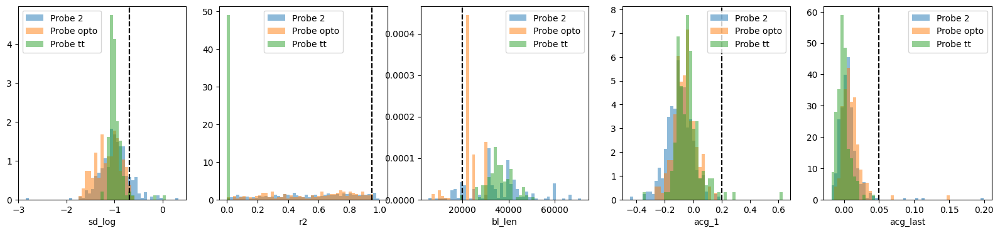

In [21]:
filter_list = ['sd_log', 'r2', 'bl_len', 'acg_1', 'acg_last']
cut_dict = {
    'sd_log': np.log(0.5 + 1e-3),
    'r2': 0.95,
    'bl_len': 20000,
    'acg_1': 0.2,
    'acg_last': 0.05
}
# acg_cut = 0.025
# sd_mean_cut = 0.5
# R2_cut = 0.95
# bl_len_cut = 30000
acf_df['acg_1'] = all_acf_bl[:, 1]
acf_df['acg_last'] = all_acf_bl[:, -1]
acf_df['sd_log'] = np.log10(acf_df['sd'] + 1e-3)
acf_df_probe = acf_df.merge(combined_tagged_units_filtered[['session', 'unit_id', 'probe', 'isi_violations']], on=['session', 'unit_id'], how='left')
probes = acf_df_probe['probe'].unique()
fig, axes = plt.subplots(1, len(filter_list), figsize=(4*len(filter_list), 4))
for ind, filter_var in enumerate(filter_list):
    ax = axes[ind]
    data = acf_df_probe[filter_var].values
    if filter_var == 'sd':
        data = np.log10(data + 1e-3)
    bins = np.linspace(np.nanmin(data), np.nanmax(data), 50)
    for probe in probes:
        probe_mask = acf_df_probe['probe'] == probe
        data_probe = data[probe_mask]
        if np.sum(~np.isnan(data_probe)) > 0:
            ax.hist(data_probe, bins=bins, alpha=0.5, label=f'Probe {probe}', density=True)
        ax.axvline(cut_dict[filter_var], color='k', linestyle='--')
    ax.set_xlabel(filter_var)
    ax.legend()
# filter = (acf_df_probe['acg_last']<=cut_dict['acg_last']) & (all_sd < sd_mean_cut) & (all_r2 < R2_cut) & (all_bl_len > bl_len_cut) & (unit_filter)
# acf_df_probe['be_filter'] = filter

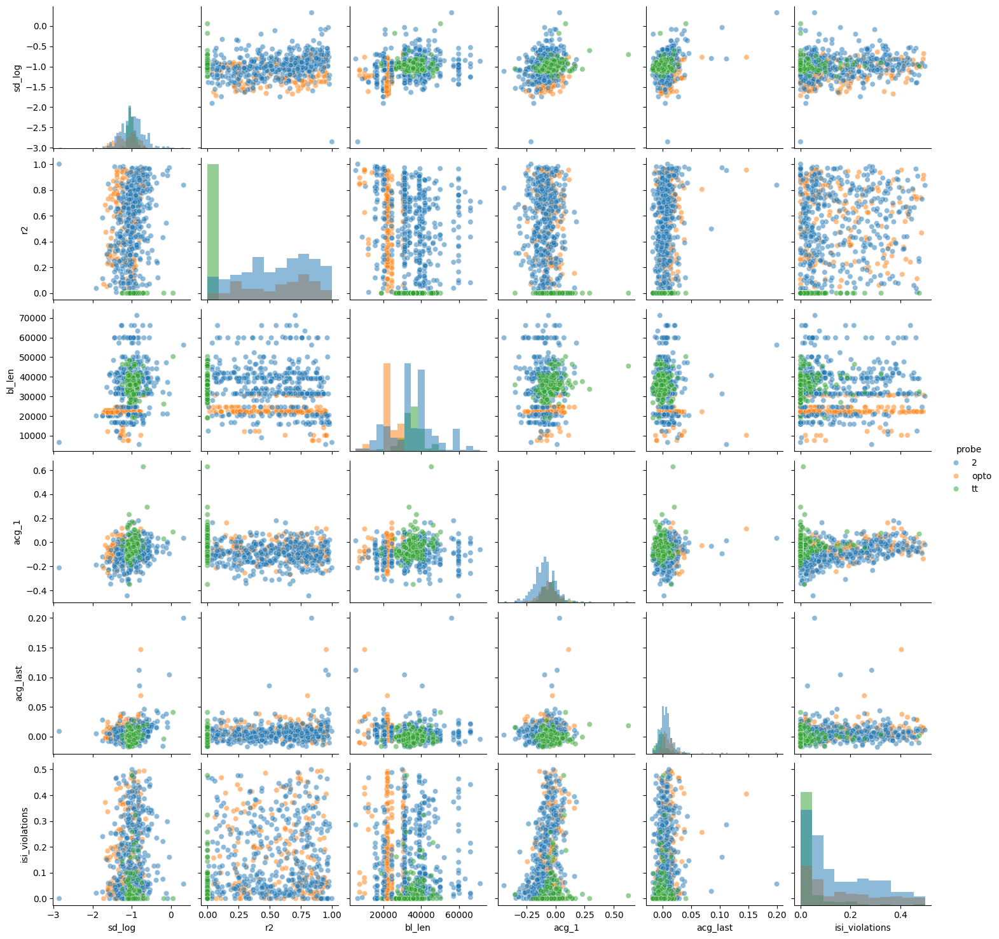

In [22]:
sns.pairplot(
    acf_df_probe[filter_list + ['probe', 'isi_violations']],
    vars=filter_list + ['isi_violations'],
    hue='probe',
    diag_kind='hist',
    plot_kws={'alpha': 0.5},
    diag_kws={'edgecolor': None, 'linewidth': 0}
)


In [23]:
filter = (acf_df_probe['acg_last']<=cut_dict['acg_last']) & (acf_df_probe['sd_log'] < cut_dict['sd_log']) & (acf_df_probe['r2'] < cut_dict['r2']) & (acf_df_probe['bl_len'] > cut_dict['bl_len'])
acf_df_probe['be_filter'] = filter

In [24]:
acf_df_probe[~filter][['session', 'unit_id', 'isi_violations']+filter_list].to_csv('excluded_units_acf.csv')

In [25]:
# PCA on acg
pca = PCA(n_components=5)
end_ind = 25

all_acf = np.array(acf_df['acg'].tolist())
all_acf_bl = np.array(acf_df['acg_bl'].tolist())
all_acf_bl_end = np.mean(all_acf_bl[:, -5:], axis=1, keepdims=True)
all_acf_bl = all_acf_bl - all_acf_bl_end
# pca_result = pca.fit_transform(zscore(all_acf_bl[filter, 1:end_ind], axis = 0))
pca_result = pca.fit_transform(all_acf_bl[acf_df_probe['be_filter'].values, 1:end_ind])
# recontruct the ACF curves by pca scores
pca_reconstructed = pca.inverse_transform(pca_result)

basic_ephys_df = basic_ephys_df.merge(acf_df_probe, on=['session', 'unit_id'], how='left')
pc_intial = np.full((len(basic_ephys_df), 1), np.nan)
for pc_ind in range(3):
    basic_ephys_df[f'pc_{pc_ind+1}'] = pc_intial.copy()
    basic_ephys_df.loc[filter, f'pc_{pc_ind+1}'] = pca_result[:, pc_ind]

### plotting

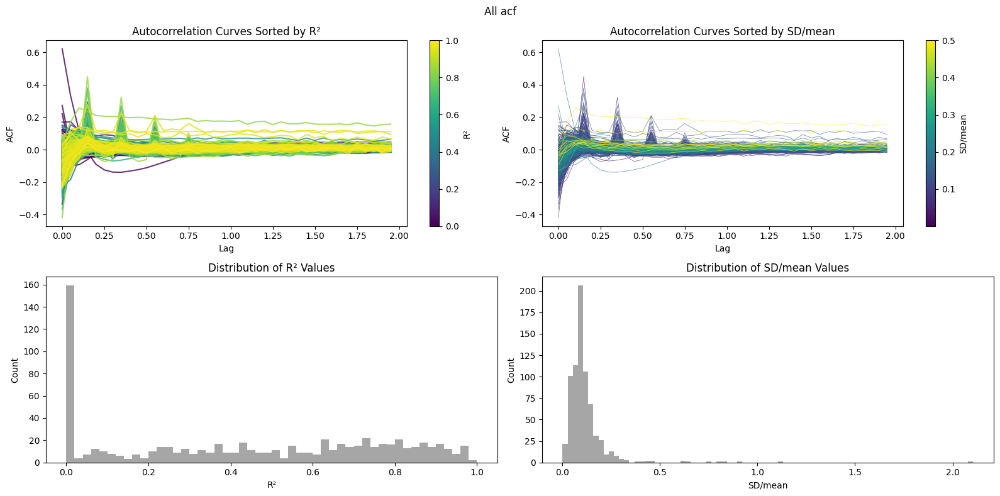

In [26]:
plt.figure(figsize=(16, 8))

ax = plt.subplot(221)

# Prepare x-axis
x_vals = np.array(range(int(window_length/auto_inhi_bin))) * auto_inhi_bin

# Sort by R²
sort_inds = np.argsort(all_r2)
sorted_r2 = all_r2[sort_inds]


# Normalize colormap
norm = mcolors.Normalize(vmin=np.nanmin(all_r2), vmax=np.nanmax(all_r2))
cmap = cm.viridis
sm = cm.ScalarMappable(norm=norm, cmap=cmap)

# Create plot
for idx in sort_inds:
    # if all_acf[idx, -1]>0.05:
    #     continue
    ax.plot(x_vals, all_acf[idx, 1:], color=cmap(norm(all_r2[idx])), alpha=0.8, linewidth=1.5)

# Add colorbar
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('R²')

# Labels
ax.set_xlabel('Lag')
ax.set_ylabel('ACF')
ax.set_title('Autocorrelation Curves Sorted by R²')

ax = plt.subplot(222)


# Sort by R²
sort_inds = np.argsort(all_sd)
sorted_sd = all_sd[sort_inds]

# Normalize colormap
norm = mcolors.Normalize(vmin=np.min(all_sd), vmax=0.5)
cmap = cm.viridis
sm = cm.ScalarMappable(norm=norm, cmap=cmap)

# Create plot
for idx in sort_inds:
    # if all_acf[idx, -1]>0.05:
    #     continue
    ax.plot(x_vals, all_acf[idx, 1:], color=cmap(norm(all_sd[idx])), alpha=0.8, linewidth=0.5)

# Add colorbar
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('SD/mean')

# Labels
ax.set_xlabel('Lag')
ax.set_ylabel('ACF')
ax.set_title('Autocorrelation Curves Sorted by SD/mean')

ax = plt.subplot(223)
ax.hist(x=all_r2, bins=50, color='gray', alpha=0.7)

ax.set_xlabel('R²')
ax.set_ylabel('Count')
ax.set_title('Distribution of R² Values')
ax = plt.subplot(224)
ax.hist(x=all_sd, bins=80, color='gray', alpha=0.7)
ax.set_xlabel('SD/mean')
ax.set_ylabel('Count')
ax.set_title('Distribution of SD/mean Values')

plt.suptitle('All acf')
plt.tight_layout()
plt.show()


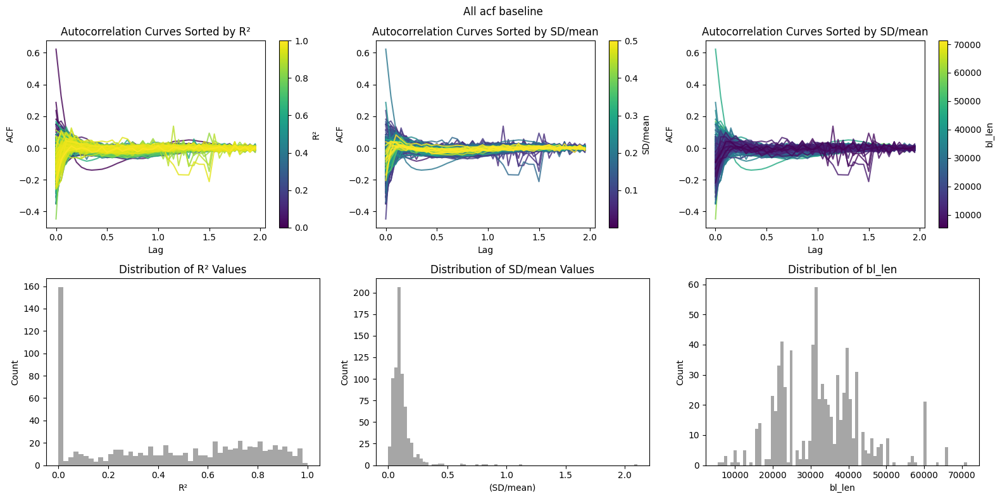

In [27]:
plt.figure(figsize=(16, 8))

ax = plt.subplot(231)

# Prepare x-axis
x_vals = np.array(range(int(window_length/auto_inhi_bin))) * auto_inhi_bin

# Sort by R²
sort_inds = np.argsort(all_r2)
sorted_r2 = all_r2[sort_inds]



# Normalize colormap
norm = mcolors.Normalize(vmin=np.nanmin(all_r2), vmax=np.nanmax(all_r2))
cmap = cm.viridis
sm = cm.ScalarMappable(norm=norm, cmap=cmap)

# Create plot
for idx in sort_inds:
    # if all_acf[idx, -1]>0.05:
    #     continue
    ax.plot(x_vals, all_acf_bl[idx, 1:], color=cmap(norm(all_r2[idx])), alpha=0.8, linewidth=1.5)

# Add colorbar
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('R²')

# Labels
ax.set_xlabel('Lag')
ax.set_ylabel('ACF')
ax.set_title('Autocorrelation Curves Sorted by R²')

ax = plt.subplot(232)


# Sort by R²
sort_inds = np.argsort(all_sd)
sorted_sd = all_sd[sort_inds]

# Normalize colormap
norm = mcolors.Normalize(vmin=np.min(all_sd), vmax=0.5)
cmap = cm.viridis
sm = cm.ScalarMappable(norm=norm, cmap=cmap)

# Create plot
for idx in sort_inds:
    # if all_acf_bl[idx, -1]>0.05:
    #     continue
    ax.plot(x_vals, all_acf_bl[idx, 1:], color=cmap(norm(all_sd[idx])), alpha=0.8, linewidth=1.5)

# Add colorbar
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('SD/mean')

# Labels
ax.set_xlabel('Lag')
ax.set_ylabel('ACF')
ax.set_title('Autocorrelation Curves Sorted by SD/mean')

ax = plt.subplot(233)


# Sort by R²
all_bl_len = acf_df['bl_len'].values
sort_inds = np.argsort(all_bl_len)[::-1]  # sort in descending order
sorted_len = all_bl_len[sort_inds]

# Normalize colormap
norm = mcolors.Normalize(vmin=np.min(sorted_len), vmax=np.max(sorted_len))
cmap = cm.viridis
sm = cm.ScalarMappable(norm=norm, cmap=cmap)

# Create plot
for idx in sort_inds:
    # if all_acf_bl[idx, -1]>0.05:
    #     continue
    ax.plot(x_vals, all_acf_bl[idx, 1:], color=cmap(norm(all_bl_len[idx])), alpha=0.8, linewidth=1.5)

# Add colorbar
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('bl_len')

# Labels
ax.set_xlabel('Lag')
ax.set_ylabel('ACF')
ax.set_title('Autocorrelation Curves Sorted by SD/mean')

ax = plt.subplot(234)
ax.hist(x=all_r2, bins=50, color='gray', alpha=0.7)
ax.set_xlabel('R²')
ax.set_ylabel('Count')
ax.set_title('Distribution of R² Values')

ax = plt.subplot(235)
ax.hist(x=all_sd, bins=80, color='gray', alpha=0.7)
ax.set_xlabel('(SD/mean)')
ax.set_ylabel('Count')
ax.set_title('Distribution of SD/mean Values')

ax = plt.subplot(236)
ax.hist(x=all_bl_len, bins=80, color='gray', alpha=0.7)
ax.set_xlabel('bl_len')
ax.set_ylabel('Count')
ax.set_title('Distribution of bl_len')

plt.suptitle('All acf baseline')
plt.tight_layout()
plt.show()



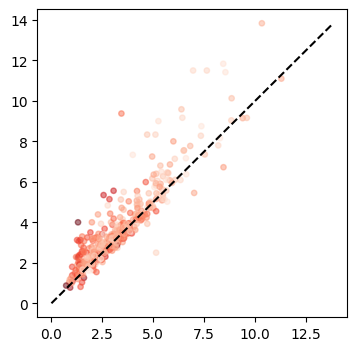

In [28]:
go_bl = basic_ephys_df['go_mean'].values[filter]
no_go_bl = basic_ephys_df['no_go_mean'].values[filter]
plt.figure(figsize=(4, 4))
plt.scatter(go_bl, no_go_bl, s=15, c=basic_ephys_df['response_rate'].values[filter], alpha=0.5, cmap='Reds')
plt.plot([0, np.nanmax(no_go_bl)], [0, np.nanmax(no_go_bl)], color='k', linestyle='--', linewidth=1.5, label='y=x')

In [29]:
basic_ephys_df.columns

Index(['session', 'unit_id', 'bl_mean', 'response_rate', 'response_bias',
       'response_diff', 'bl_diff', 'outcome_diff', 'outcome_diff_abs',
       'bl_response_corr', 'bl_response_corr_sham', 'go_mean', 'no_go_mean',
       'response_lat', 'response_isi', 'bl_response_corr_diff', 'probe_x',
       'acg', 'acg_bl', 'r2', 'r2_ori', 'sd', 'sd_ori', 'len', 'bl_len',
       'acg_1', 'acg_last', 'sd_log', 'probe_y', 'isi_violations', 'be_filter',
       'pc_1', 'pc_2', 'pc_3'],
      dtype='object')

In [30]:
# x_label = 'pc_1'
# y_label = 'pc_2'
# hue = 'x_ccf'
# test = basic_ephys_df[(basic_ephys_df['be_filter']) & (basic_ephys_df['isi_violations']<=0.1)].copy()
# sns.jointplot(data=test, x=x_label, y=y_label, hue = hue, alpha=0.5)

# nan_mask = np.isnan(basic_ephys_df[x_label].values[filter]) | np.isnan(basic_ephys_df[y_label].values[filter])
# corr, p = pearsonr(basic_ephys_df[x_label].values[filter][~nan_mask], basic_ephys_df[y_label].values[filter][~nan_mask])
# plt.suptitle(f'Correlation: {corr:.2f} p-value: {p:.5f}')
# plt.savefig(os.path.join(beh_folder, f'{x_label}_vs_{y_label}_hue_{hue}.pdf'))
# plt.tight_layout()

In [31]:
test = basic_ephys_df[(basic_ephys_df['be_filter']) & (basic_ephys_df['isi_violations']<=0.1)].copy()

Text(0.5, 1.0, 'Post filtering: Autocorrelation Curves Sorted by SD/mean')

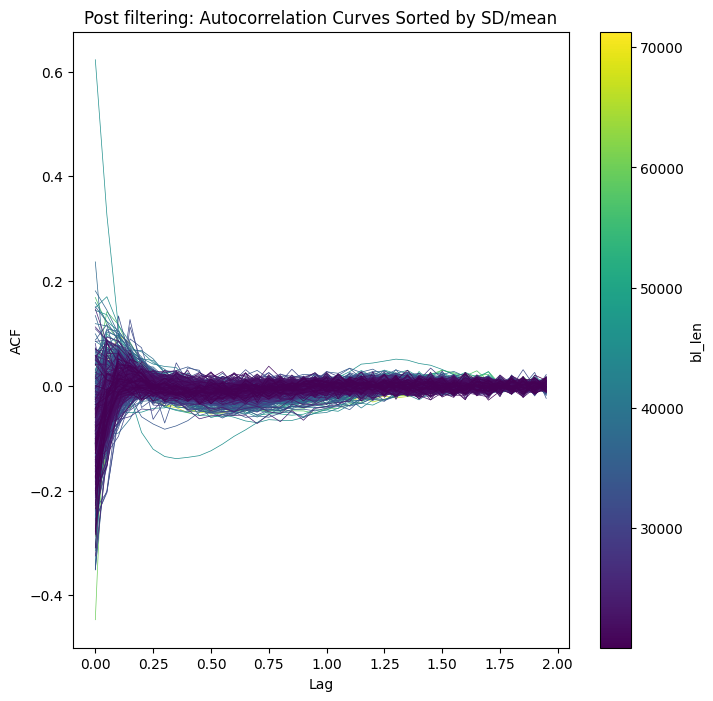

In [32]:
fig = plt.figure(figsize=(8, 8))
ax = plt.subplot(111)


# Sort by R²
sort_inds = np.argsort(all_bl_len[filter])[::-1]  # sort in descending order
sorted_len = all_bl_len[filter][sort_inds]

# Normalize colormap
norm = mcolors.Normalize(vmin=np.min(sorted_len), vmax=np.max(sorted_len))
cmap = cm.viridis
sm = cm.ScalarMappable(norm=norm, cmap=cmap)

# Create plot
for idx in sort_inds:
    # if all_acf_bl[idx, -1]>0.05:
    #     continue
    ax.plot(x_vals, all_acf_bl[filter,:][idx, 1:], color=cmap(norm(all_bl_len[filter][idx])), alpha=1, linewidth=0.5)

# Add colorbar
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('bl_len')

# Labels
ax.set_xlabel('Lag')
ax.set_ylabel('ACF')
ax.set_title('Post filtering: Autocorrelation Curves Sorted by SD/mean')

In [33]:
# # drift params
# # filter = all_acf[:, -1] < 1
# focus_ind = np.argmin(np.mean(all_acf[filter, 1:], axis=0))+1
# focus_ind = 0

# norm = mcolors.Normalize(vmin=np.min(all_acf[filter, focus_ind]), vmax=np.max(all_acf[filter, focus_ind]))
# # norm = mcolors.Normalize(vmin=np.min(all_lens), vmax=np.max(all_lens))
# cmap = cm.Reds
# sm = cm.ScalarMappable(norm=norm, cmap=cmap)
# fig = plt.figure(figsize=(18, 6))
# plt.subplot(131)
# sc = plt.scatter(all_r2[filter], 1/all_sd[filter], c=all_acf[filter, focus_ind], cmap=cmap, norm=norm, alpha=0.7)
# plt.xlabel('R²')
# plt.ylabel('SD/mean')
# cbar = plt.colorbar(sc)
# cbar.set_label('ACF at Lag = {:.2f}s'.format(focus_ind * auto_inhi_bin))

# plt.subplot(132)
# cmap = cm.Reds
# sm = cm.ScalarMappable(norm=norm, cmap=cmap)
# norm = mcolors.Normalize(vmin=np.min(all_acf_bl[filter, focus_ind]), vmax=np.max(all_acf_bl[filter, focus_ind]))
# sc = plt.scatter(all_r2[filter], 1/all_sd[filter], c=all_acf_bl[filter, focus_ind], cmap=cmap, norm=norm, alpha=0.7)
# plt.xlabel('R²')
# plt.ylabel('SD/mean')
# cbar = plt.colorbar(sc)
# cbar.set_label('ACF baseline at Lag = {:.2f}s'.format(focus_ind * auto_inhi_bin))

# plt.subplot(133)
# # plt.scatter(all_acf[:, focus_ind], all_acf[:, focus_ind], s = 10)
# # plt.plot([-0.3, 0.3], [-0.3, 0.3], color='k', linestyle='--', alpha=0.5, linewidth=1.5)
# plt.hist(all_acf[:, focus_ind]-all_acf_bl[:, focus_ind], bins=50, color='gray', alpha=0.7)
# plt.xlabel('acf')
# plt.ylabel('acf baseline')

Text(0.5, 1.0, 'Focus time: 0.05 s')

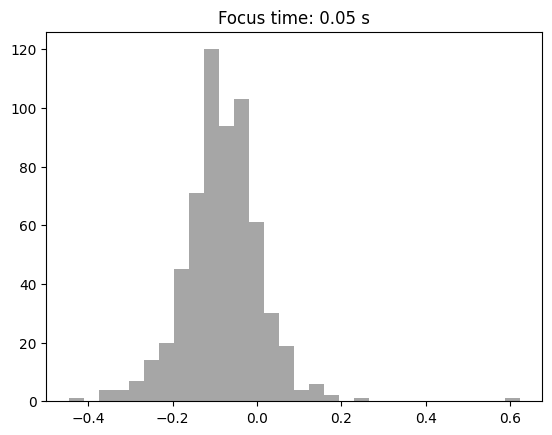

In [34]:
# filter = all_acf[:, -1] < 1
focus_ind = np.argmin(np.mean(all_acf[filter, 1:], axis=0))+1
focus_ind = 1
plt.hist(all_acf_bl[filter, focus_ind], bins=30, color='gray', alpha=0.7, label='ACF at last lag');
plt.title(f'Focus time: {x_vals[focus_ind]:.2f} s')

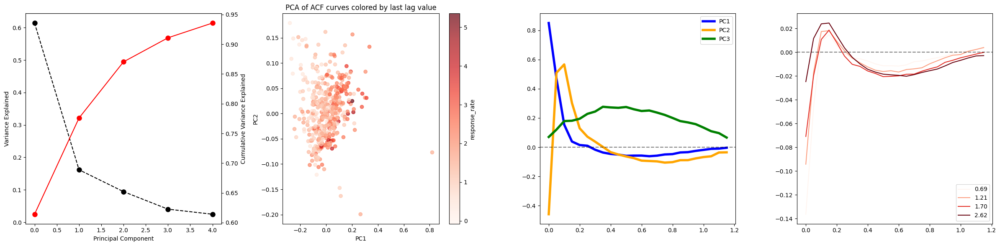

In [35]:
# Assume all_acf and filter are defined appropriately
# Example dummy structure:
# all_acf = np.random.rand(100, 20)
# filter = (all_acf[:, -1] < 0.05) & (combined_tagged_units_filtered['unit']!=131) & ~((combined_tagged_units_filtered['unit']==197) & (combined_tagged_units_filtered['session']=="behavior_716325_2024-05-31_10-31-14"))

# Normalize and colormap for color mapping
# focus_feature = 'response_rate'
focus_feature = 'response_rate'
color_values = basic_ephys_df[focus_feature].values[basic_ephys_df['be_filter']]
focus_values = basic_ephys_df[focus_feature].values[basic_ephys_df['be_filter']]
norm = mcolors.Normalize(vmin=np.nanmin(color_values), vmax=np.nanmax(color_values))
cmap = cm.Reds

# Create scatter plot
plt.figure(figsize=(24, 6))
plt.subplot(141)
plt.plot(pca.explained_variance_ratio_[:], marker='o', linestyle='--', color='k', markersize=8)
plt.xlabel('Principal Component')
plt.ylabel('Variance Explained')
# flip to right y axis
plt.twinx().plot(np.cumsum(pca.explained_variance_ratio_), marker='o', linestyle='-', color='r', markersize=8)
plt.ylabel('Cumulative Variance Explained')

plt.subplot(142)
sc = plt.scatter(basic_ephys_df['pc_1'].values[basic_ephys_df['be_filter']], basic_ephys_df['pc_2'].values[basic_ephys_df['be_filter']], c=color_values, cmap=cmap, norm=norm, alpha=0.7)

# Create and link colorbar
cbar = plt.colorbar(sc)
cbar.set_label(focus_feature)

# Labels
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA of ACF curves colored by last lag value')


plt.subplot(143)
# plot the 2 pcs
plt.plot(x_vals[:end_ind-1], pca.components_[0], label='PC1', color='blue', linewidth=4)
plt.plot(x_vals[:end_ind-1], pca.components_[1], label='PC2', color='orange', linewidth=4)
plt.plot(x_vals[:end_ind-1], pca.components_[2], label='PC3', color='g', linewidth=4)
plt.axhline(0, color='k', linestyle='--', alpha=0.5, linewidth=1.5)
plt.legend()

plt.subplot(144)
# bin acf by focus feature and plot mean
numbins = 4
# bins = np.linspace(np.nanmin(focus_values), np.nanmax(focus_values), numbins+1)
bins = np.quantile(focus_values[~np.isnan(focus_values)], np.linspace(0, 1, numbins+1))
bin_means = []
acf_means = []
all_acf_bl = np.array(basic_ephys_df['acg_bl'].tolist())
for i in range(numbins):
    bin_mask = (focus_values >= bins[i]) & (focus_values < bins[i+1])
    bin_means.append(np.nanmean(focus_values[bin_mask]))
    # acf_means.append(np.mean(pca_reconstructed[bin_mask, :], axis=0))
    acf_means.append(np.nanmean(all_acf_bl[filter][bin_mask, 1:end_ind], axis=0))

colors = cmap(np.linspace(0, 1, numbins))
for i in range(numbins):
    plt.plot(x_vals[:end_ind-1], acf_means[i], color=colors[i], label = f'{bin_means[i]:.2f}')
plt.axhline(0, color='k', linestyle='--', alpha=0.5, linewidth=1.5)

plt.legend()
plt.tight_layout()

plt.savefig(os.path.join(beh_folder, f'pca_autoinhibition_{criteria_name}.pdf'), bbox_inches='tight')



In [36]:
# Create normalization object
norm = mcolors.Normalize(vmin=-0.118, vmax=0.120)
# Apply colormap with normalization
colors = cmap(norm(bin_means))

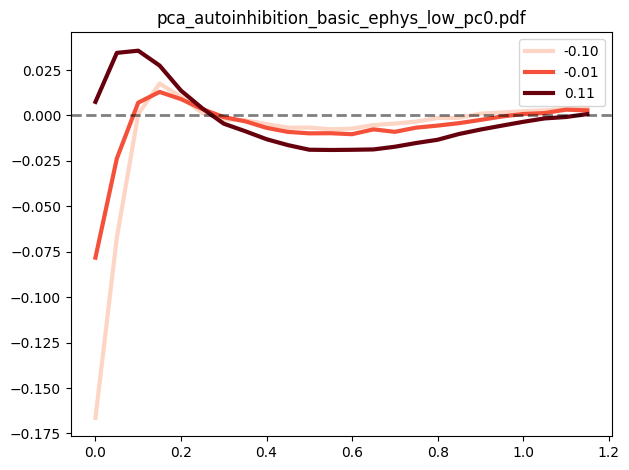

In [37]:
numbins = 3
pc_focus = 0
# bins = np.linspace(np.nanmin(focus_values), np.nanmax(focus_values), numbins+1)
bins = np.quantile(pca_result[:, pc_focus], np.linspace(0, 1, numbins+1))
bin_means = []
acf_means = []
for i in range(numbins):
    bin_mask = (pca_result[:, pc_focus] >= bins[i]) & (pca_result[:, pc_focus] < bins[i+1])
    bin_means.append(np.nanmean(pca_result[bin_mask, pc_focus]))
    # acf_means.append(np.mean(pca_reconstructed[bin_mask, :], axis=0))
    acf_means.append(np.nanmean(all_acf_bl[filter][bin_mask, 1:end_ind], axis=0))
cmap = cm.Reds
colors = cmap(norm(bin_means)+0.1)
for i in range(numbins):
    plt.plot(x_vals[:end_ind-1], acf_means[i], color=colors[i], label = f'{bin_means[i]:.2f}', linewidth = 3)
plt.axhline(0, color='k', linestyle='--', alpha=0.5, linewidth=2)
plt.title(f'pca_autoinhibition_{criteria_name}_pc{pc_focus}.pdf')
plt.legend()
plt.tight_layout()
plt.savefig(os.path.join(beh_folder, f'pca_autoinhibition_{criteria_name}_pc{pc_focus}.pdf'), bbox_inches='tight')


Text(0.5, 1.0, 'R²: 0.22')

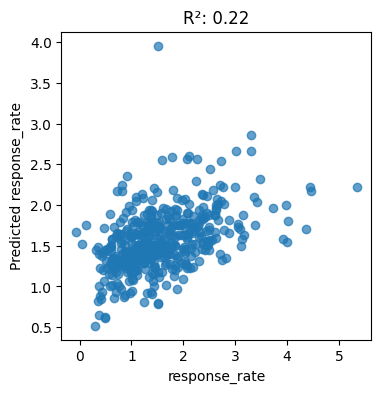

In [38]:
lm = LinearRegression()
X = pca_result[:, :3]
y = basic_ephys_df[focus_feature].values[filter]
nan_filter = np.isnan(y) | np.isnan(X[:, 0])
lm.fit(X[~nan_filter], y[~nan_filter])
lm.coef_, lm.intercept_
focus_feature_predicted = lm.predict(X)
R2 = lm.score(X[~nan_filter], y[~nan_filter])
plt.figure(figsize=(4, 4))
plt.scatter(basic_ephys_df[focus_feature].values[filter], focus_feature_predicted,  norm=norm, alpha=0.7)
plt.xlabel(focus_feature)
plt.ylabel(ylabel='Predicted ' + focus_feature)
plt.title(f'R²: {R2:.2f}')

UndefinedVariableError: name 'unit' is not defined

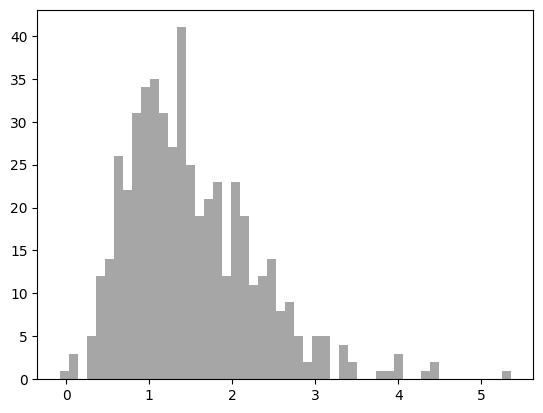

In [39]:
plt.hist(basic_ephys_df['response_rate'], bins=50, color='gray', alpha=0.7);
test_df = basic_ephys_df.query('unit == 197')
print(test_df.head(5))
plt.figure(figsize=(8, 6))
plt.plot(x_vals, all_acf[test_df.index, 1:].T, color='gray', alpha=0.7, label='All units');

In [ ]:
# # plot all acf with their id
# plt.figure(figsize=(30, 30))
# for i in range(len(all_acf)):
#     ax = plt.subplot(20, 20, i+1)
#     ax.plot(x_vals, all_acf[i, 1:], color='gray', alpha=0.7)
#     ax.set_title(combined_tagged_units_filtered.iloc[i]['session'] + str(combined_tagged_units_filtered.iloc[i]['unit']))

## Add bursting around go cue

In [ ]:
# # get all t-stats, coeffs, p-values for the two groups
# # grab all tagged units and combine spike waveforms
# from sklearn.mixture import GaussianMixture
# from sklearn.metrics import silhouette_score
# from sklearn.metrics import calinski_harabasz_score
# from sklearn.metrics import davies_bouldin_score
# from scipy.stats import norm
# import math

# data_type = 'curated'
# target = 'soma'

# pre_event = -1.5
# post_event = 3
# binSize = 0.5

# auto_inhi_bin = 0.05
# window_length = 2.0
# pre_time = 0
# post_time = 3

# all_isi_mode = []
# all_isi_burst_bi_si = []
# all_isi_burst_bi_ca = []
# all_isi_burst_bi_da = []
# all_isi_burst_bi_dp = []
# all_isi_burst_ratio = []
# all_isi_burst_mode = []
# all_isi_non_burst_mode = []
# all_isi_sep = []
# all_isi_v = []
# fig = plt.figure(figsize=(50, 50))
# gs = gridspec.GridSpec(int(np.ceil(np.sqrt(len(combined_tagged_units_filtered)))), 
#                        int(np.ceil(np.sqrt(len(combined_tagged_units_filtered)))))
# loaded_session = None
# for ind, row in combined_tagged_units_filtered.iterrows():
#     session = row['session']
#     unit_id = row['unit']
#     all_isi_v.append(row['isi_violations'])
#     # check if different session
#     if loaded_session is None or loaded_session != session:
#         session_dir = session_dirs(session)
#         unit_tbl = get_unit_tbl(session, data_type)
#         drift_data = load_trial_drift(session, data_type)
#         qm_dict_file = os.path.join(session_dir['processed_dir'], f'{session}_qm.json')
#         with open(qm_dict_file, 'r') as f:
#             qm_dict = json.load(f)
#         rec_start = qm_dict['ephys_cut'][0]
#         rec_end = qm_dict['ephys_cut'][1]
#         opto_file = os.path.join(session_dir['opto_dir_curated'], 
#                                     f'{session}_opto_session.csv')
#         if os.path.exists(opto_file):
#             opto_tbl = pd.read_csv(opto_file)
#             opto_times = opto_tbl['time'].values
#         else:
#             opto_times = np.array([])

#         if row['in_df']:
#             session_df = makeSessionDF(session)
#             session_df_go_cue = get_session_tbl(session)
#             # session_df['ipsi'] = 2*(session_df['choice'].values - 0.5) * row['rec_side']
#             in_df = True
#         else:
#             # if session_df exists, delete it to free memory
#             if 'session_df' in locals():
#                 del session_df
#                 del session_df_go_cue
#                 del session_df_curr
#             in_df = False
#         loaded_session = session
#         print(f'Processing session: {session}')

#     unit_drift = load_drift(session, unit_id, data_type=data_type)
#     spike_times = unit_tbl.query('unit_id == @unit_id')['spike_times'].values[0]
#     spike_times_curr = spike_times.copy()
#     opto_times_curr = opto_times.copy()
#     rec_start_curr = rec_start
#     rec_end_curr = rec_end
#     if unit_drift is not None:
#         if unit_drift['ephys_cut'][0] is not None:
#             spike_times_curr = spike_times_curr[spike_times_curr >= unit_drift['ephys_cut'][0]]
#             rec_start_curr = unit_drift['ephys_cut'][0]
#             opto_times_curr = opto_times_curr[opto_times_curr >= unit_drift['ephys_cut'][0]]
#         if unit_drift['ephys_cut'][1] is not None:
#             spike_times_curr = spike_times_curr[spike_times_curr <= unit_drift['ephys_cut'][1]]
#             rec_end_curr = unit_drift['ephys_cut'][1]
#             opto_times_curr = opto_times_curr[opto_times_curr <= unit_drift['ephys_cut'][1]]
#     if in_df:
#         session_df_curr = session_df.copy()
#         session_df_go_cue_curr = session_df_go_cue.copy()
#         # tblTrials_curr = tblTrials.copy()
#         if unit_drift is not None:
#             if unit_drift['ephys_cut'][0] is not None:
#                 spike_times_curr = spike_times_curr[spike_times_curr >= unit_drift['ephys_cut'][0]]
#                 session_df_curr = session_df_curr[session_df_curr['go_cue_time'] >= unit_drift['ephys_cut'][0]]
#                 session_df_go_cue_curr = session_df_go_cue_curr[session_df_go_cue_curr['goCue_start_time'] >= unit_drift['ephys_cut'][0]]
#                 # tblTrials_curr = tblTrials_curr[tblTrials_curr['goCue_start_time'] >= unit_drift['ephys_cut'][0]]
#             if unit_drift['ephys_cut'][1] is not None:
#                 spike_times_curr = spike_times_curr[spike_times_curr <= unit_drift['ephys_cut'][1]]
#                 session_df_curr = session_df_curr[session_df_curr['go_cue_time'] <= unit_drift['ephys_cut'][1]]
#                 session_df_go_cue_curr = session_df_go_cue_curr[session_df_go_cue_curr['goCue_start_time'] <= unit_drift['ephys_cut'][1]]
#                 # tblTrials_curr = tblTrials_curr[tblTrials_curr['goCue_start_time'] <= unit_drift['ephys_cut'][1]]
#         # calculate auto-inhibition
#         if len(session_df_go_cue_curr) > 0:
#             print(f"Processing unit {unit_id}.")
#             # clean up those within 5 samples
#             all_isi = np.diff(spike_times_curr)
#             dup_inds = np.where(all_isi < 5*(1/30000))[0]
#             spike_times_curr = np.delete(spike_times_curr, dup_inds+1)
#             all_isi = np.diff(spike_times_curr)
#             if len(np.where(all_isi < 0)[0]) > 0:
#                 print(f"Negative ISI found in unit {unit_id}.")
#                 all_isi = all_isi[all_isi > 0]
#             all_isi = np.log(all_isi)

#             # calculate ISI mode by calculating mean of ISIs between 45% and 55%
#             isi_mode = np.mean(all_isi[(all_isi > np.quantile(all_isi, 0.45)) & (all_isi < np.quantile(all_isi, 0.55))])
#             # get isi from go cue period
#             align_time = session_df_go_cue_curr['goCue_start_time'].values
#             spike_df = align.to_events(spike_times_curr, align_time, (0, 10), return_df=True)
#             # for each value in event_index, get the first spike time
#             first_spike_times = np.full(len(session_df_go_cue_curr), np.nan)
#             for i in range(len(session_df_go_cue_curr)):
#                 spikes_in_trial = spike_df[spike_df['event_index']==i]['time']
#                 if len(spikes_in_trial) > 0:
#                     first_spike_times[i] = spikes_in_trial.min()
#             first_spike_times_abs = first_spike_times + align_time

#             df = align.to_events(spike_times_curr, first_spike_times_abs, (-0.05, 0.03), return_df=True)

#             isi_list = df.copy()
#             isi_list['isi'] = np.nan
#             # infer time interval of previous spike for each spike
#             for ind_s, row_s in isi_list.iterrows():
#                 event_index = row_s['event_index']
#                 time = row_s['time']
#                 prev_spikes = spike_times_curr[spike_times_curr < (time + first_spike_times_abs[int(event_index)])]
#                 if len(prev_spikes) == 0:
#                     isi_list.at[ind_s, 'isi'] = np.nan
#                 else:
#                     isi_list.at[ind_s, 'isi'] = time + first_spike_times_abs[[int(event_index)]] - prev_spikes[-1]

#             go_isi = np.log(isi_list['isi'].dropna().values)

#             # calculate burst index by GMM and then calculate separation index)
#             # Fit a 2-component GMM
#             gmm = GaussianMixture(n_components=2)
#             gmm.fit(go_isi.reshape(-1, 1))
#             means = gmm.means_.flatten()
#             stds = np.sqrt(gmm.covariances_).flatten()
#             # silhouette_score
#             labels = gmm.predict(go_isi.reshape(-1, 1))
#             score_si = silhouette_score(go_isi.reshape(-1, 1), labels)
#             # from sklearn.metrics import calinski_harabasz_score
#             score_sa = calinski_harabasz_score(go_isi.reshape(-1, 1), labels)

#             # from sklearn.metrics import davies_bouldin_score
#             score_da = davies_bouldin_score(go_isi.reshape(-1, 1), labels)

#             # best separation point
#             # Extract means and stds
#             weights = gmm.weights_

#             idx = np.argsort(means)
#             m1, m2 = means[idx]
#             s1, s2 = stds[idx]
#             w1, w2 = weights[idx]

#             A = 1/(2*s1**2) - 1/(2*s2**2)
#             B = m2/(s2**2) - m1/(s1**2)
#             C = (m1**2)/(2*s1**2) - (m2**2)/(2*s2**2) + math.log((s2*w1)/(s1*w2))

#             discriminant = B**2 - 4*A*C

#             if discriminant < 0:
#                 print("No real intersection points.")
#                 sep_point = np.nan
#             else:
#                 x1 = (-B + np.sqrt(discriminant)) / (2*A)
#                 x2 = (-B - np.sqrt(discriminant)) / (2*A)
                
#                 # Find the intersection point that lies between the two means
#                 candidates = [x1, x2]
#                 sep_point = np.nan
#                 for x in candidates:
#                     if m1 < x < m2:
#                         sep_point = x
#                         break
            
#             # d prime:

#             # Compute d-prime
#             d_prime = np.abs(m2 - m1) / np.sqrt(0.5 * (s1**2 + s2**2))

#             # burst rate
#             # mean of two modes:
#             burst_mode = m1
#             non_burst_mode = m2

#             if means[0] < means[1]:
#                 burst_rate = np.sum(labels == 0) / len(labels)
#             else:
#                 burst_rate = np.sum(labels == 1) / len(labels)


            
#             all_isi_mode.append(isi_mode)
#             all_isi_burst_bi_si.append(score_si)
#             all_isi_burst_bi_ca.append(score_sa)
#             all_isi_burst_bi_da.append(score_da)
#             all_isi_burst_bi_dp.append(d_prime)
#             all_isi_burst_ratio.append(burst_rate)
#             all_isi_burst_mode.append(burst_mode)
#             all_isi_non_burst_mode.append(non_burst_mode)
#             all_isi_sep.append(sep_point)

#             ax = plt.subplot(gs[ind])
#             bins = np.linspace(np.nanmin(all_isi), np.nanmax(all_isi), 50)
#             ax.hist(all_isi, bins=bins, color='gray', alpha=0.7, label='All ISI', density=True)
#             ax.hist(go_isi, bins=bins, color='blue', alpha=0.7, label='Go ISI', density=True)
#             ax.axvline(burst_mode, color='r', linestyle='--', label='ISI mode')
#             ax.axvline(non_burst_mode, color='g', linestyle='--', label='Non-burst mode')
#             if ~np.isnan(sep_point):
#                 ax.axvline(sep_point, color='k', linestyle='--', label='Separation point')
#                 ax.set_title(label=f'Si {score_si:.2f} Ca {score_sa:.2f} da {score_da:.2f}')
#                 ax.set_title(f'dp {d_prime:.2f} br {burst_rate:.2f}', color='k')
#             else:
#                 ax.set_title('no sep')
#                 ax.set_title(label=f'Si {score_si:.2f} Ca {score_sa:.2f} da {score_da:.2f}', color='red')
#                 ax.set_title(f'dp {d_prime:.2f} br {burst_rate:.2f}', color='red')

#             # set y ticks invisible
#             ax.set_yticks([])
#             ax.set_ylabel(f'{np.round(row["amp_raw"])} isi: {row["isi_violations"]:.2f}')
            
#             # session_start = session_df_go_cue_curr['goCue_start_time'].values[0]-10
#             # session_end = session_df_go_cue_curr['goCue_start_time'].values[-1]+20
#             # all_lens.append(session_end - session_start) .
#             # counts = np.histogram(spike_times_curr, bins=np.arange(session_start, session_end, auto_inhi_bin))[0]
#             # starts = np.arange(session_start, session_end, auto_inhi_bin)[:-1]
#             # ends = np.arange(session_start, session_end, auto_inhi_bin)[1:]
            
#             # # remove periods within session
#             # counts_bl = counts.copy().astype(float)
#             # if len(session_df_go_cue_curr) > 0:
#             #     for ind, row in session_df_go_cue_curr.iterrows():
#             #         start_time = row['goCue_start_time'] - pre_time
#             #         end_time = row['goCue_start_time'] + post_time
#             #         # set counts in this period to np.nan
#             #         mask = (ends >= start_time) & (starts <= end_time)
#             #         if np.sum(mask) > 0:
#             #             counts_bl[mask] = np.nan
#         else:
#             all_isi_mode.append(np.nan)
#             all_isi_burst_bi_si.append(np.nan)
#             all_isi_burst_bi_ca.append(np.nan)
#             all_isi_burst_bi_da.append(np.nan)
#             all_isi_burst_bi_dp.append(np.nan)
#             all_isi_burst_ratio.append(np.nan)
#             all_isi_burst_mode.append(np.nan)
#             all_isi_non_burst_mode.append(np.nan)   
#             all_isi_sep.append(np.nan)
#     else:
#         all_isi_mode.append(np.nan)
#         all_isi_burst_bi_si.append(np.nan)
#         all_isi_burst_bi_ca.append(np.nan)
#         all_isi_burst_bi_da.append(np.nan)
#         all_isi_burst_bi_dp.append(np.nan)
#         all_isi_burst_ratio.append(np.nan)
#         all_isi_burst_mode.append(np.nan)
#         all_isi_non_burst_mode.append(np.nan)
#         all_isi_sep.append(np.nan)


In [ ]:
# burst_df = pd.DataFrame({
#     'session': combined_tagged_units_filtered['session'],
#     'unit': combined_tagged_units_filtered['unit'],
#     'isi_mode': all_isi_mode,
#     'burst_bi_si': all_isi_burst_bi_si,
#     'burst_bi_ca': all_isi_burst_bi_ca,
#     'burst_bi_da': all_isi_burst_bi_da,
#     'burst_bi_dp': all_isi_burst_bi_dp,
#     'burst_ratio': all_isi_burst_ratio,
#     'burst_mode': all_isi_burst_mode,
#     'non_burst_mode': all_isi_non_burst_mode,
#     'sep': all_isi_sep,
#     'amp': combined_tagged_units_filtered['amp_raw'],
#     'isi': combined_tagged_units_filtered['isi_violations'],
# })

In [ ]:
# Par version
from joblib import Parallel, delayed
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import numpy as np, pandas as pd, math, json, os
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

def process_unit_burst(row, make_plot=False):
    """Compute ISI/burst metrics for one unit safely."""
    session = row['session']
    unit_id = row['unit_id']
    isi_v = row['isi_violations']
    in_df = row['in_df']

    session_dir = session_dirs(session)
    unit_tbl = get_unit_tbl(session, data_type)
    drift_data = load_trial_drift(session, data_type)

    qm_file = os.path.join(session_dir['processed_dir'], f'{session}_qm.json')
    with open(qm_file, 'r') as f:
        qm_dict = json.load(f)
    rec_start, rec_end = qm_dict['ephys_cut']

    # Load opto times
    opto_file = os.path.join(session_dir['opto_dir_curated'], f'{session}_opto_session.csv')
    if os.path.exists(opto_file):
        opto_tbl = pd.read_csv(opto_file)
        opto_times = opto_tbl['time'].values
    else:
        opto_times = np.array([])

    if in_df:
        session_df = makeSessionDF(session)
        session_df_go_cue = get_session_tbl(session)
    else:
        session_df = None
        session_df_go_cue = None

    # Load drift data
    unit_drift = load_drift(session, unit_id, data_type=data_type)

    # Load spikes
    spike_times = unit_tbl.query('unit_id == @unit_id')['spike_times'].values[0]
    spike_times_curr = spike_times.copy()
    opto_times_curr = opto_times.copy()
    rec_start_curr, rec_end_curr = rec_start, rec_end

    # Trim according to drift
    if unit_drift is not None:
        if unit_drift['ephys_cut'][0] is not None:
            spike_times_curr = spike_times_curr[spike_times_curr >= unit_drift['ephys_cut'][0]]
            rec_start_curr = unit_drift['ephys_cut'][0]
            opto_times_curr = opto_times_curr[opto_times_curr >= unit_drift['ephys_cut'][0]]
        if unit_drift['ephys_cut'][1] is not None:
            spike_times_curr = spike_times_curr[spike_times_curr <= unit_drift['ephys_cut'][1]]
            rec_end_curr = unit_drift['ephys_cut'][1]
            opto_times_curr = opto_times_curr[opto_times_curr <= unit_drift['ephys_cut'][1]]

    # Skip if no behavioral info
    if not in_df or session_df_go_cue is None or len(session_df_go_cue) == 0:
        return dict(session=session, unit=unit_id, isi_mode=np.nan, burst_bi_si=np.nan,
                    burst_bi_ca=np.nan, burst_bi_da=np.nan, burst_bi_dp=np.nan,
                    burst_ratio=np.nan, burst_mode=np.nan, non_burst_mode=np.nan,
                    sep=np.nan, isi_violations=isi_v, amp=row['amp_raw'])

    # ISI computation
    all_isi = np.diff(spike_times_curr)
    dup_inds = np.where(all_isi < 5*(1/30000))[0]
    spike_times_curr = np.delete(spike_times_curr, dup_inds+1)
    all_isi = np.diff(spike_times_curr)
    all_isi = all_isi[all_isi > 0]
    all_isi = np.log(all_isi)

    isi_mode = np.mean(all_isi[(all_isi > np.quantile(all_isi, 0.45)) & (all_isi < np.quantile(all_isi, 0.55))])

    align_time = session_df_go_cue['goCue_start_time'].values
    spike_df = align.to_events(spike_times_curr, align_time, (0, 10), return_df=True)
    first_spike_times = np.full(len(session_df_go_cue), np.nan)
    for i in range(len(session_df_go_cue)):
        spikes_in_trial = spike_df[spike_df['event_index']==i]['time']
        if len(spikes_in_trial) > 0:
            first_spike_times[i] = spikes_in_trial.min()
    first_spike_times_abs = first_spike_times + align_time
    df = align.to_events(spike_times_curr, first_spike_times_abs, (-0.05, 0.03), return_df=True)

    isi_list = df.copy()
    isi_list['isi'] = np.nan
    for ind_s, row_s in isi_list.iterrows():
        event_index = row_s['event_index']
        time = row_s['time']
        prev_spikes = spike_times_curr[spike_times_curr < (time + first_spike_times_abs[int(event_index)])]
        if len(prev_spikes) == 0:
            isi_list.at[ind_s, 'isi'] = np.nan
        else:
            isi_list.at[ind_s, 'isi'] = time + first_spike_times_abs[[int(event_index)]] - prev_spikes[-1]
    go_isi = np.log(isi_list['isi'].dropna().values)

    if len(go_isi) < 10:
        return dict(session=session, unit=unit_id, isi_mode=isi_mode, burst_bi_si=np.nan,
                    burst_bi_ca=np.nan, burst_bi_da=np.nan, burst_bi_dp=np.nan,
                    burst_ratio=np.nan, burst_mode=np.nan, non_burst_mode=np.nan,
                    sep=np.nan, isi_violations=isi_v, amp=row['amp_raw'])

    # --- GMM fit ---
    gmm = GaussianMixture(n_components=2)
    gmm.fit(go_isi.reshape(-1, 1))
    means = gmm.means_.flatten()
    stds = np.sqrt(gmm.covariances_).flatten()
    labels = gmm.predict(go_isi.reshape(-1, 1))
    score_si = silhouette_score(go_isi.reshape(-1, 1), labels)
    score_ca = calinski_harabasz_score(go_isi.reshape(-1, 1), labels)
    score_da = davies_bouldin_score(go_isi.reshape(-1, 1), labels)

    weights = gmm.weights_
    idx = np.argsort(means)
    m1, m2 = means[idx]
    s1, s2 = stds[idx]
    w1, w2 = weights[idx]

    A = 1/(2*s1**2) - 1/(2*s2**2)
    B = m2/(s2**2) - m1/(s1**2)
    C = (m1**2)/(2*s1**2) - (m2**2)/(2*s2**2) + math.log((s2*w1)/(s1*w2))
    discriminant = B**2 - 4*A*C
    sep_point = np.nan
    if discriminant >= 0:
        x1 = (-B + np.sqrt(discriminant)) / (2*A)
        x2 = (-B - np.sqrt(discriminant)) / (2*A)
        for x in [x1, x2]:
            if m1 < x < m2:
                sep_point = x
                break
    d_prime = np.abs(m2 - m1) / np.sqrt(0.5 * (s1**2 + s2**2))
    burst_mode, non_burst_mode = m1, m2
    burst_ratio = np.sum(labels == idx[0]) / len(labels)

    # (optional) plotting
    if make_plot:
        fig, ax = plt.subplots(figsize=(4, 3))
        bins = np.linspace(np.nanmin(all_isi), np.nanmax(all_isi), 50)
        ax.hist(all_isi, bins=bins, color='gray', alpha=0.6, label='All ISI', density=True)
        ax.hist(go_isi, bins=bins, color='blue', alpha=0.6, label='Go ISI', density=True)
        ax.axvline(burst_mode, color='r', linestyle='--')
        ax.axvline(non_burst_mode, color='g', linestyle='--')
        if not np.isnan(sep_point):
            ax.axvline(sep_point, color='k', linestyle='--')
        ax.set_title(f'{session} unit {unit_id}')
        plt.close(fig)

    return dict(session=session, unit=unit_id, isi_mode=isi_mode,
                burst_bi_si=score_si, burst_bi_ca=score_ca, burst_bi_da=score_da,
                burst_bi_dp=d_prime, burst_ratio=burst_ratio, burst_mode=burst_mode,
                non_burst_mode=non_burst_mode, sep=sep_point,
                isi_violations=isi_v, amp=row['amp_raw'])



In [ ]:
data_type = 'curated'
target = 'soma'
make_plot = False

# Parameters
auto_inhi_bin = 0.05
window_length = 2.0
pre_time = 0
post_time = 3


# ---------------------------------------------------------------------
# PARALLEL EXECUTION
# ---------------------------------------------------------------------

results = Parallel(n_jobs=4, backend='loky', verbose=10)(
    delayed(process_unit_burst)(row) for _, row in combined_tagged_units_filtered.iterrows()
)

burst_df = pd.DataFrame(results)


[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    3.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    3.2s
[Parallel(n_jobs=4)]: Done  17 tasks      | elapsed:    3.8s
[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done  33 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done  53 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:   11.2s
[Parallel(n_jobs=4)]: Done  77 tasks      | elapsed:   12.6s
[Parallel(n_jobs=4)]: Done  90 tasks      | elapsed:   13.5s
[Parallel(n_jobs=4)]: Done 105 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:   15.9s
[Parallel(n_jobs=4)]: Done 137 tasks      | elapsed:   17.4s
[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:   18.7s
[Parallel(n_jobs=4)]: Done 173 tasks      | elapsed:   20.5s
[Parallel(

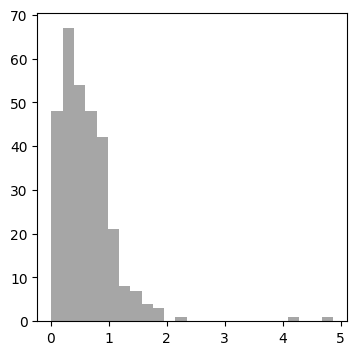

In [ ]:
fig = plt.figure(figsize=(4, 4))

plt.hist(burst_df['burst_bi_dp'].values * burst_df['burst_ratio'].values, bins=25, color='gray', alpha=0.7, label='burst d-prime * burst ratio');

Text(0.5, 1.0, 'mode:-2.26')

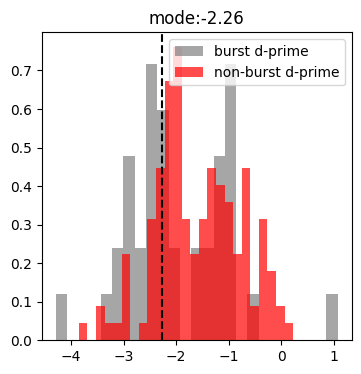

In [ ]:
burst = burst_df['burst_bi_dp'].values * burst_df['burst_ratio'].values>=1
sep_value = burst_df['sep'].values
fig = plt.figure(figsize=(4, 4))
plt.hist(burst_df['sep'].values[burst], bins=25, color='gray', alpha=0.7, label='burst d-prime', density= True);
plt.hist(burst_df['sep'].values[~burst], bins=25, color='red', alpha=0.7, label='non-burst d-prime', density= True);
plt.legend()
sep_mode = np.mean(sep_value[burst][(sep_value[burst]>np.quantile(sep_value[burst], 0.45)) & (sep_value[burst]<np.quantile(sep_value[burst], 0.55))])
plt.axvline(sep_mode, color='k', linestyle='--', label='mode')
plt.title(f'mode:{sep_mode:.2f}')

In [ ]:
burst_df['burst'] = burst

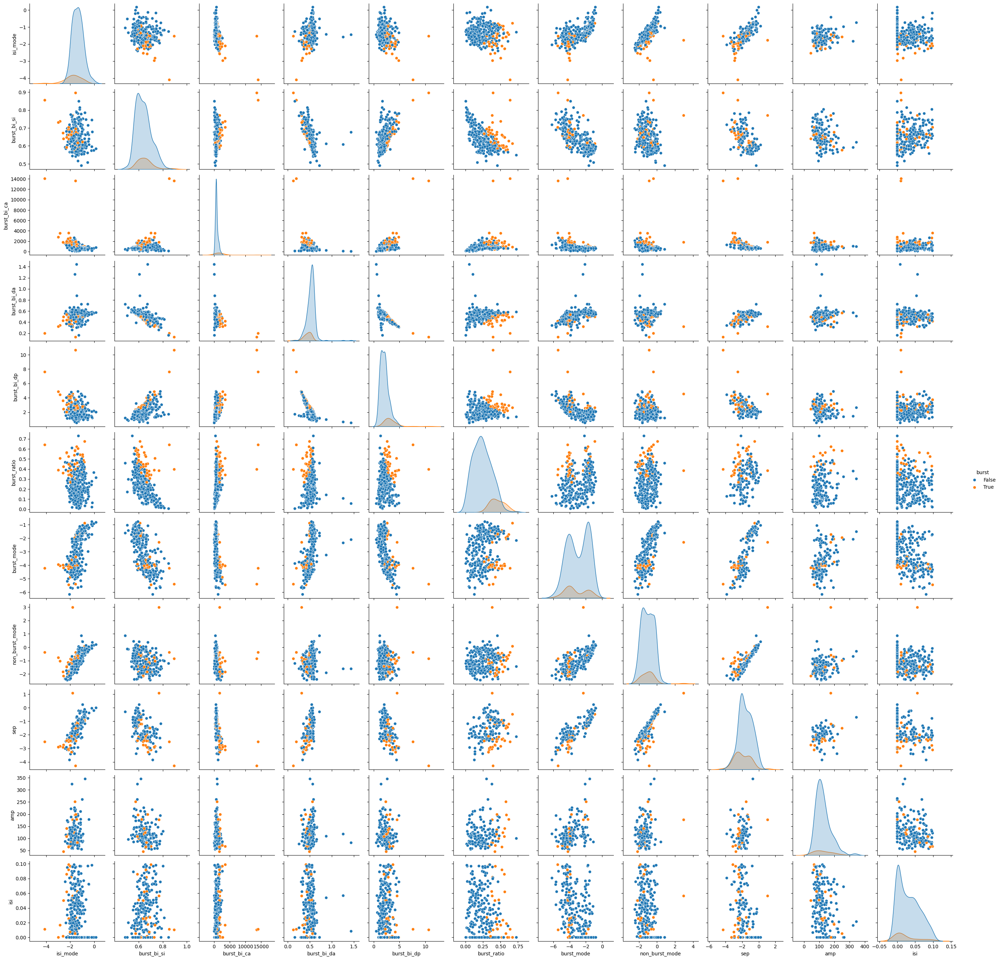

In [ ]:
sns.pairplot(burst_df, hue='burst')

In [ ]:
burst_df.rename(columns={'unit':'unit_id'}, inplace=True)

In [ ]:
# merge with basic_ephys
basic_ephys_df = pd.merge(basic_ephys_df, burst_df[['session', 'unit_id', 'burst_ratio', 'burst_bi_dp']], on=['session', 'unit_id'], how='left')

In [ ]:
basic_ephys_df.rename(columns={'probe_x': 'probe'}, inplace=True)

In [ ]:
# save basic ephys data
with open(os.path.join(beh_folder, f'basic_ephys.pkl'), 'wb') as f:
    pickle.dump(basic_ephys_df, f)

In [88]:
features_be

['bl_mean',
 'response_rate',
 'response_bias',
 'response_diff',
 'bl_diff',
 'outcome_diff',
 'outcome_diff_abs',
 'bl_response_corr',
 'bl_response_corr_sham',
 'go_mean',
 'no_go_mean',
 'bl_response_corr_diff',
 'r2',
 'r2_ori',
 'sd',
 'sd_ori',
 'len',
 'bl_len',
 'acg_1',
 'acg_last',
 'sd_log',
 'isi_violations',
 'pc_1',
 'pc_2',
 'pc_3',
 'burst_ratio',
 'burst_bi_dp']

In [95]:
features_be = basic_ephys_df.columns.to_list()
# Keep only numeric columns
features_be = [f for f in features_be if np.issubdtype(basic_ephys_df[f].dtype, np.number)]

# Create the pairplot
g = sns.pairplot(
    data=basic_ephys_df[features_be],
    vars=features_be,
    plot_kws={'alpha': 0.5, 's': 5}
)

# Make all x and y axis labels visible
for ax in g.axes.flatten():
    # Only continue if this subplot exists
    if ax is not None:
        ax.set_xlabel(ax.get_xlabel(), fontsize=8)
        ax.set_ylabel(ax.get_ylabel(), fontsize=8)
        ax.xaxis.label.set_visible(True)
        ax.yaxis.label.set_visible(True)

# Optional: adjust label rotation and spacing for clarity
for ax in g.axes[-1, :]:
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right", fontsize=6)
for ax in g.axes[:, 0]:
    plt.setp(ax.get_yticklabels(), rotation=0, fontsize=6)

g.fig.tight_layout()

# Save to files
plt.savefig(os.path.join(beh_folder, 'basic_ephys_pairplot.pdf'), bbox_inches='tight')
plt.savefig(os.path.join(beh_folder, 'basic_ephys_pairplot.png'), bbox_inches='tight')
plt.close()


# Basic ephys in space

In [66]:
be_path = os.path.join(beh_folder, f'basic_ephys.pkl')
with open(be_path, 'rb') as f:
    basic_ephys_df = pickle.load(f)

In [70]:
features_be = basic_ephys_df.columns.to_list()
# keep only those that are values
features_be = [f for f in features_be if np.issubdtype(basic_ephys_df[f].dtype, np.number)]

In [48]:
filter = (combined_tagged_units_filtered['unit']!=131) & ~((combined_tagged_units_filtered['unit']==197) & (combined_tagged_units_filtered['session']=="behavior_716325_2024-05-31_10-31-14"))
# create mask for units that pass the criteria
# filter = (all_acf[:, -1] < acf_cut) & (all_sd < sd_mean_cut) & (all_r2 < R2_cut) & (all_bl_len > bl_len_cut) & (unit_filter)

In [49]:
combined_tagged_units_filtered.columns

Index(['session', 'unit', 'qc_pass', 'opto_tagged', 'opto_tagging_pre',
       'opto_tagging_post', 'anti', 'in_df', 'trial_count', 'p_max',
       'sig_counts', 'p_mean', 'lat_max_p', 'isi_violations', 'snr', 'eu',
       'corr', 'amp', 'amp_raw', 'peak', 'peak_raw', 'wf', 'wf_raw',
       'wf_aligned', 'wf_2d', 'wf_2d_raw', 'probe', 'y_loc', 'rec_side', 'top',
       'bottom', 'tag_loc', 'fr', 'decoder', 'all_p_max', 'all_p_mean',
       'all_lat_max_p', 'all_corr', 'all_eu', 'all_sig_counts', 'x_ccf',
       'y_ccf', 'z_ccf', 'selected_qc_only', 'count_max', 'selected_opto_only',
       'selected', 'selected_no_opto'],
      dtype='object')

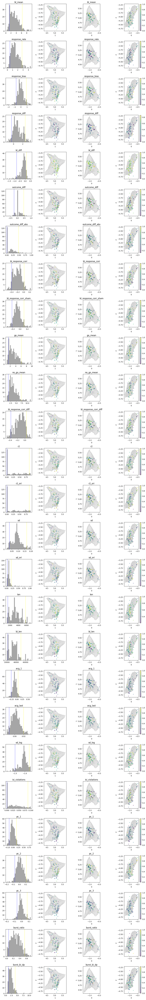

In [83]:
from matplotlib.colors import Normalize
norm = Normalize(vmin=0, vmax=1)

ml, ap, dv = 0, 1, 2
planes = {'sag': [ap, dv], 'hor': [ml, ap], 'cor': [ml, dv]}

mesh = load_mesh('/root/capsule/scratch/combined/ccf_maps/20250418_transformed_remesh_10_ccf25.obj')
mesh_vertices = np.array(mesh.vertices)
mesh_vertices = (mesh_vertices - np.array([216, 18, 228]))*25/1000
mesh_vertices_lps = pir_to_lps(mesh_vertices) # convert to lps
mesh_vertices_mm = mesh_vertices_lps
mesh_vertices_mm[:, ml] = -mesh_vertices_mm[:, ml]


blue_white_red = LinearSegmentedColormap.from_list(
    'blue_white_red',
    [(0, 'blue'), (0.5, 'white'), (1.0, 'red')]
)

combined_df = pd.merge(basic_ephys_df, combined_tagged_units_filtered[['session', 'unit_id', 'x_ccf', 'y_ccf', 'z_ccf']], on=['session', 'unit_id'], how='left')
fig, axes = plt.subplots(len(features_be), 4, figsize=(12, 3*len(features_be)))
filter = basic_ephys_df['be_filter'].values & (basic_ephys_df['isi_violations']<=0.1)
for ind, feature in enumerate(features_be):
    ax = axes[ind, 0]
    color_code_filtered = basic_ephys_df[feature].values[filter]
    # if it is boolean, convert to float
    if np.issubdtype(color_code_filtered.dtype, np.bool_):
        color_code_filtered = color_code_filtered.astype(float)
    ax.hist(color_code_filtered, bins=30, color='gray', alpha=0.7)
    ax.set_title(feature)
    top_90 = np.quantile(color_code_filtered[~np.isnan(color_code_filtered)], 0.95)
    bottom_10 = np.quantile(color_code_filtered[~np.isnan(color_code_filtered)], 0.05)
    ax.axvline(top_90, color='yellow', linestyle='--', linewidth=1)
    ax.axvline(bottom_10, color='blue', linestyle='--', linewidth=1)
    color_code_nl = color_code_filtered.copy()
    color_code_nl[color_code_nl > top_90] = top_90
    color_code_nl[color_code_nl < bottom_10] = bottom_10
    color_code_nl = (color_code_nl - bottom_10) / (top_90 - bottom_10)  # Normalize color code to [0, 1] using 10-90% quantiles
    # x_ccf = combined_tagged_units_filtered['x_ccf'].values
    # y_ccf = combined_tagged_units_filtered['y_ccf'].values
    # z_ccf = combined_tagged_units_filtered['z_ccf'].values

    ccfs = combined_df[['x_ccf', 'y_ccf', 'z_ccf']].values
    bregma_LPS_mm = np.array([-5.74, 5.4, -0.45])  # in mm
    ccfs = ccfs - bregma_LPS_mm

    # ccfs = np.column_stack((x_ccf, y_ccf, z_ccf))
    # ccfs = ccf_pts_convert_to_mm(ccfs)
    ccfs[:, ml] = -np.abs(ccfs[:, ml])  # Mirror ML to left
    for plane, ax in zip(planes.keys(), axes[ind, 1:]):
        # Plot the mesh
        ax.scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
        # Plot the points
        sc = ax.scatter(ccfs[filter, planes[plane][0]], ccfs[filter, planes[plane][1]], c=color_code_nl, cmap='viridis', s=20, edgecolor='none', alpha=0.4)
        if plane == 'hor':
            ax.set_title(feature)
        ax.set_xlabel(planes[plane][0])
        ax.set_ylabel(planes[plane][1])
        # set equal aspect ratio
        ax.set_aspect('equal')
        # if planes[plane][1] == dv:
        #     ax.invert_yaxis()
        if plane == 'cor':
            fig.colorbar(sc, ax=ax, orientation='vertical', fraction=0.05)

    plt.tight_layout()
fig.savefig(fname=os.path.join(beh_folder, f'basic_ephys_spatial_distribution_{criteria_name}.pdf'), bbox_inches='tight')


In [85]:
import os
import numpy as np
import k3d
from matplotlib import cm
from matplotlib.colors import Normalize
from trimesh import load_mesh

# --- Load and preprocess mesh ---
mesh = load_mesh('/root/capsule/scratch/combined/ccf_maps/20250418_transformed_remesh_10_ccf25.obj')
mesh_vertices = np.array(mesh.vertices)
mesh_vertices = (mesh_vertices - np.array([216, 18, 228])) * 25 / 1000  # convert to mm
mesh_vertices_lps = pir_to_lps(mesh_vertices)
mesh_vertices_lps[:, 0] = -mesh_vertices_lps[:, 0]  # mirror ML

# --- Common settings ---
ml, ap, dv = 0, 1, 2
bregma_LPS_mm = np.array([-5.74, 5.4, -0.45])  # in mm
norm = Normalize(vmin=0, vmax=1)

# Use viridis colormap
cmap = cm.get_cmap('viridis')

# --- Iterate through features ---
for feature in features_be:
    color_code_filtered = basic_ephys_df[feature].values[filter]
    
    # Convert boolean to float
    if np.issubdtype(color_code_filtered.dtype, np.bool_):
        color_code_filtered = color_code_filtered.astype(float)
    
    # Clip 2.5–97.5 percentile range for color scaling
    top_90 = np.nanquantile(color_code_filtered, 0.95)
    bottom_10 = np.nanquantile(color_code_filtered, 0.05)
    color_code_nl = np.clip(color_code_filtered, bottom_10, top_90)
    color_code_nl = (color_code_nl - bottom_10) / (top_90 - bottom_10)
    color_code_nl[np.isnan(color_code_nl)] = 0.0

    # --- Get 3D coordinates ---
    ccfs = combined_df[['x_ccf', 'y_ccf', 'z_ccf']].values - bregma_LPS_mm
    ccfs[:, ml] = -np.abs(ccfs[:, ml])  # Mirror to left hemisphere

    # --- Convert colormap to uint32 for K3D ---
    rgba = cmap(color_code_nl)
    rgb = (rgba[:, :3] * 255).astype(np.uint32)
    colors = (rgb[:, 0] << 16) + (rgb[:, 1] << 8) + rgb[:, 2]

    # --- Create K3D plot ---
    plt_3d = k3d.plot(camera_auto_fit=True, background_color=0x000000, grid_visible=False)

    # Add mesh (light gray surface)
    if hasattr(mesh, 'faces'):
        faces = np.array(mesh.faces).astype(np.uint32)
        plt_3d += k3d.mesh(mesh_vertices_lps.astype(np.float32), faces,
                           color=0xaaaaaa, opacity=0.15)

    # Add data points
    plt_3d += k3d.points(
        positions=ccfs[filter].astype(np.float32),
        colors=colors.astype(np.uint32),
        point_size=0.07,
        shader='3d',
        opacity=0.4,
        name=feature
    )

    # Display in notebook (optional)
    plt_3d.display()

    # --- Save as HTML ---
    html_path = f'{beh_folder}/k3d_plots/{feature}_3d.html'
    os.makedirs(os.path.dirname(html_path), exist_ok=True)

    with open(html_path, 'w') as f:
        f.write(plt_3d.get_snapshot())
    print(f"Saved {feature} → {html_path}")


Output()

Saved bl_mean → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/bl_mean_3d.html


Output()

Saved response_rate → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/response_rate_3d.html


Output()

Saved response_bias → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/response_bias_3d.html


Output()

Saved response_diff → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/response_diff_3d.html


Output()

Saved bl_diff → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/bl_diff_3d.html


Output()

Saved outcome_diff → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/outcome_diff_3d.html


Output()

Saved outcome_diff_abs → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/outcome_diff_abs_3d.html


Output()

Saved bl_response_corr → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/bl_response_corr_3d.html


Output()

Saved bl_response_corr_sham → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/bl_response_corr_sham_3d.html


Output()

Saved go_mean → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/go_mean_3d.html


Output()

Saved no_go_mean → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/no_go_mean_3d.html


Output()

Saved bl_response_corr_diff → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/bl_response_corr_diff_3d.html


Output()

Saved r2 → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/r2_3d.html


Output()

Saved r2_ori → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/r2_ori_3d.html


Output()

Saved sd → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/sd_3d.html


Output()

Saved sd_ori → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/sd_ori_3d.html


Output()

Saved len → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/len_3d.html


Output()

Saved bl_len → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/bl_len_3d.html


Output()

Saved acg_1 → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/acg_1_3d.html


Output()

Saved acg_last → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/acg_last_3d.html


Output()

Saved sd_log → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/sd_log_3d.html


Output()

Saved isi_violations → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/isi_violations_3d.html


Output()

Saved pc_1 → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/pc_1_3d.html


Output()

Saved pc_2 → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/pc_2_3d.html


Output()

Saved pc_3 → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/pc_3_3d.html


Output()

Saved burst_ratio → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/burst_ratio_3d.html


Output()

Saved burst_bi_dp → /root/capsule/scratch/combined/beh_plots/basic_ephys_low/k3d_plots/burst_bi_dp_3d.html


In [135]:
# pca in basic ephys features
focus_features = ['bl_mean', 
                'response_rate',
                'bl_response_corr_diff', 'bl_response_corr',
                'pc_1', 'pc_2', 'pc_3']
filter = basic_ephys_df['be_filter'].values & (basic_ephys_df['isi_violations']<=0.2)

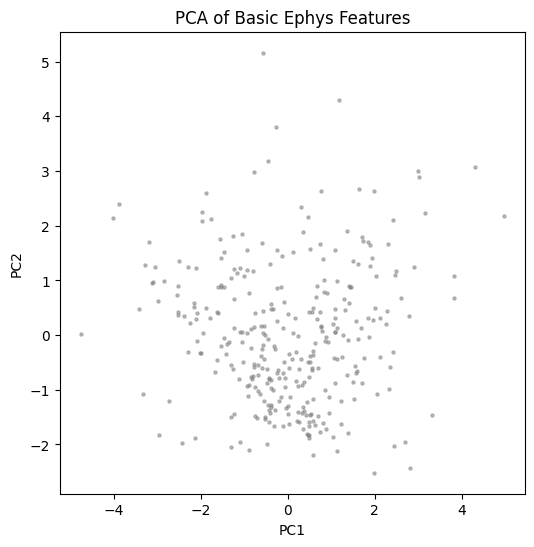

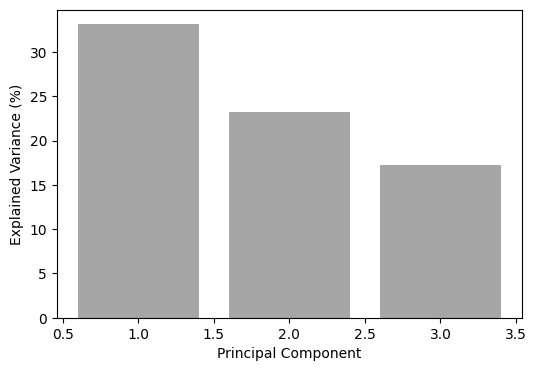

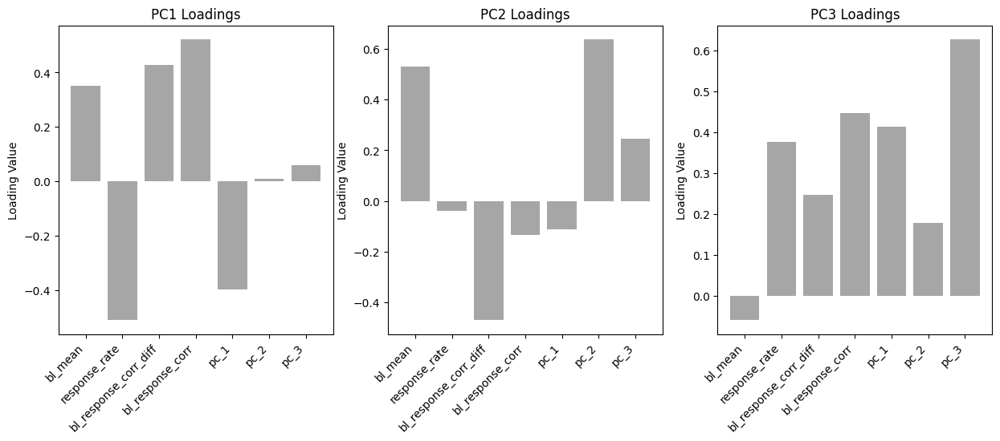

In [136]:
from sklearn.decomposition import PCA
feature_mat = basic_ephys_df[focus_features].values[filter]
# remove rows with nan
nan_ind = np.isnan(feature_mat).any(axis=1)
feature_mat = feature_mat[~nan_ind]
# zscore
from scipy.stats import zscore
feature_mat = zscore(feature_mat, axis=0, nan_policy='omit')

pca = PCA(n_components=3)
pca_result = pca.fit_transform(feature_mat)
# plot
fig = plt.figure(figsize=(6, 6))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c='gray', alpha=0.5, s=5)
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA of Basic Ephys Features')
# plot explained variance ratio
explained_var = pca.explained_variance_ratio_
fig = plt.figure(figsize=(6, 4))
plt.bar(range(1, len(explained_var)+1), explained_var*100, color='gray', alpha=0.7)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance (%)')

# plot how each features contribute to each PC, plot by PC
components = pca.components_
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i in range(3):
    ax = axes[i]
    ax.bar(focus_features, components[i], color='gray', alpha=0.7)
    ax.set_title(f'PC{i+1} Loadings')
    ax.set_ylabel('Loading Value')
    ax.set_xticklabels(focus_features, rotation=45, ha='right')

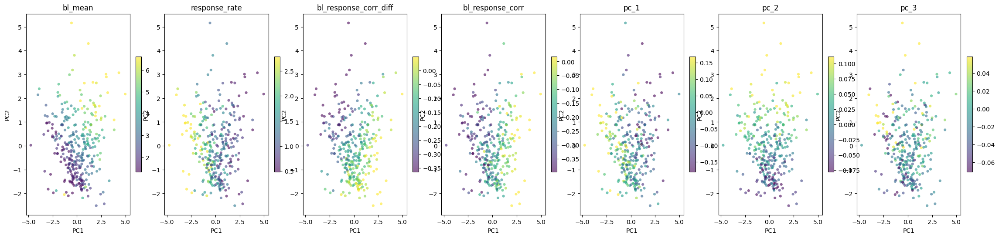

In [158]:
# plot focus features in pc space

fig, axes = plt.subplots(1, len(focus_features), figsize=(4*len(focus_features), 6))
for i, feature in enumerate(focus_features):
    ax = axes[i]
    color_code_filtered = basic_ephys_df[feature].values[filter]
    # if it is boolean, convert to float
    if np.issubdtype(color_code_filtered.dtype, np.bool_):
        color_code_filtered = color_code_filtered.astype(float)
    # remove nan
    color_code_filtered = color_code_filtered[~nan_ind]
    # clip to 2.5-97.5 percentile
    top_90 = np.quantile(color_code_filtered[~np.isnan(color_code_filtered)], 0.95)
    bottom_10 = np.quantile(color_code_filtered[~np.isnan(color_code_filtered)], 0.05)
    color_code_filtered[color_code_filtered > top_90] = top_90
    color_code_filtered[color_code_filtered < bottom_10] = bottom_10
    # color_code_filtered = (color_code_filtered - bottom_10) / (top_90 - bottom_10)  # Normalize color code to [0, 1] using 10-90% quantiles

    sc = ax.scatter(pca_result[:, 0], pca_result[:, 1], c=color_code_filtered, cmap='viridis', s=20, edgecolor='none', alpha=0.6)
    ax.set_title(feature)
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    fig.colorbar(sc, ax=ax, orientation='vertical', fraction=0.05)

In [ ]:
# append pc to basic_ephys_df
pc_filtered = np.full((np.sum(filter), 3), np.nan)
pc_filtered[~nan_ind] = pca_result
basic_ephys_df['be_pc_1'] = np.nan
basic_ephys_df['be_pc_2'] = np.nan
basic_ephys_df['be_pc_3'] = np.nan
basic_ephys_df.loc[filter, 'be_pc_1'] = pc_filtered[:, 0]
basic_ephys_df.loc[filter, 'be_pc_2'] = pc_filtered[:, 1]
basic_ephys_df.loc[filter, 'be_pc_3'] = pc_filtered[:, 2]

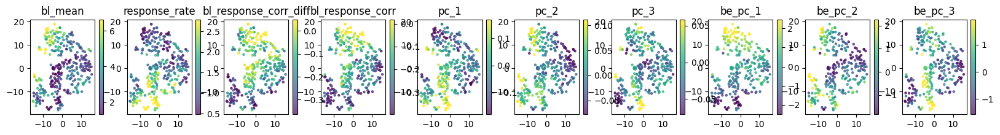

In [150]:
# try tsne
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_result = tsne.fit_transform(feature_mat)
# plot focus features as color code
fig, axes = plt.subplots(1, len(focus_features)+3, figsize=(20, 2))
for i, feature in enumerate(focus_features+['be_pc_1', 'be_pc_2', 'be_pc_3']):
    ax = axes[i]
    color_code = basic_ephys_df[feature].values[filter]
    color_code = color_code[~nan_ind]
    # clip to 5-95 percentile
    top_90 = np.nanquantile(color_code, 0.95)
    bottom_10 = np.nanquantile(color_code, 0.05)
    color_code[color_code > top_90] = top_90
    color_code[color_code < bottom_10] = bottom_10
    sc = ax.scatter(tsne_result[:, 0], tsne_result[:, 1], c=color_code, cmap='viridis', s=5, alpha=0.7)
    ax.set_title(feature)
    plt.colorbar(sc, ax=ax)


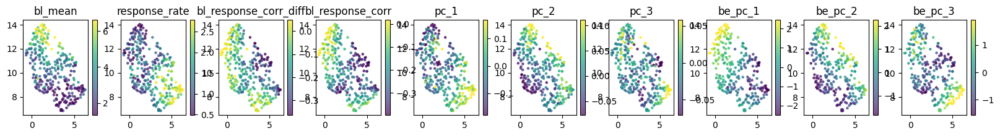

In [155]:
# try UMAP
import umap.umap_ as umap

reducer = umap.UMAP(n_components=2, random_state=42, n_neighbors=30, min_dist=0.2)
umap_result = reducer.fit_transform(feature_mat)
# plot focus features as color code
fig, axes = plt.subplots(1, len(focus_features)+3, figsize=(20, 2))
for i, feature in enumerate(focus_features+['be_pc_1', 'be_pc_2', 'be_pc_3']):
    ax = axes[i]
    color_code = basic_ephys_df[feature].values[filter]
    color_code = color_code[~nan_ind]
    # clip to 5-95 percentile
    top_90 = np.nanquantile(color_code, 0.95)
    bottom_10 = np.nanquantile(color_code, 0.05)
    color_code[color_code > top_90] = top_90
    color_code[color_code < bottom_10] = bottom_10
    sc = ax.scatter(umap_result[:, 0], umap_result[:, 1], c=color_code, cmap='viridis', s=5, alpha=0.7)
    ax.set_title(feature)
    plt.colorbar(sc, ax=ax)

In [152]:
# add umap to basic_ephys_df
umap_filtered = np.full((np.sum(filter), 2), np.nan)
umap_filtered[~nan_ind] = umap_result
basic_ephys_df['be_umap_1'] = np.nan
basic_ephys_df['be_umap_2'] = np.nan
basic_ephys_df.loc[filter, 'be_umap_1'] = umap_filtered[:, 0]
basic_ephys_df.loc[filter, 'be_umap_2'] = umap_filtered[:, 1]


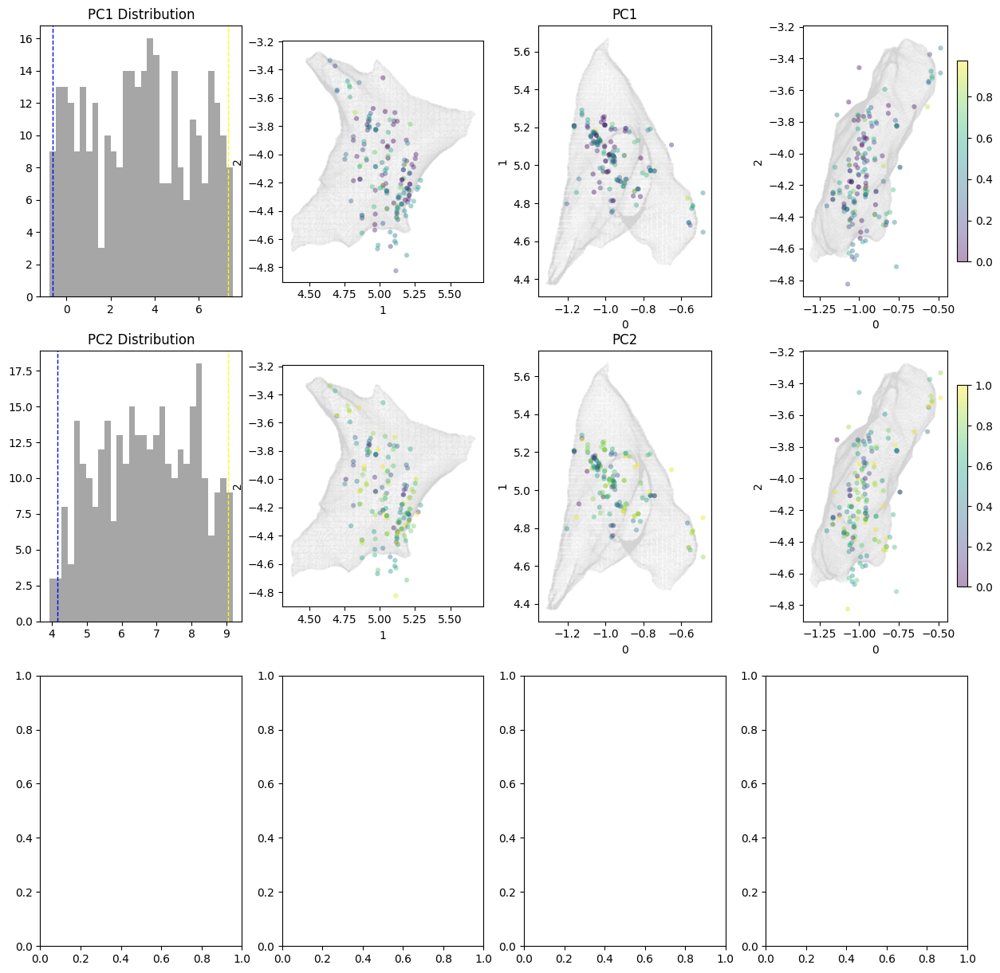

In [224]:
# plot pc values in 2D space using ccf locations as color code
fig, axes = plt.subplots(3, 4, figsize=(15, 15))
ccfs = combined_df[['x_ccf', 'y_ccf', 'z_ccf']].values[filter]
ccfs = ccfs - bregma_LPS_mm
ccfs[:, ml] = -np.abs(ccfs[:, ml])  # Mirror ML to left

for i in range(2):
    pc_values = basic_ephys_df[f'be_umap_{i+1}'].values[filter]
    # clip to 2.5-97.5 percentile
    top_90 = np.nanquantile(pc_values, 0.99)
    bottom_10 = np.nanquantile(pc_values, 0.01)
    pc_values_nl = np.clip(pc_values, bottom_10, top_90)
    pc_values_nl = (pc_values_nl - bottom_10) / (top_90 - bottom_10)
    pc_values_nl[np.isnan(pc_values_nl)] = 0.0

    rgba = cmap(pc_values_nl)
    rgb = (rgba[:, :3] * 255).astype(np.uint32)
    colors = (rgb[:, 0] << 16) + (rgb[:, 1] << 8) + rgb[:, 2]

    ax = axes[i, 0]
    ax.hist(pc_values, bins=30, color='gray', alpha=0.7)
    ax.set_title(f'PC{i+1} Distribution')
    ax.axvline(top_90, color='yellow', linestyle='--', linewidth=1)
    ax.axvline(bottom_10, color='blue', linestyle='--', linewidth=1)

    for j, plane in enumerate(planes.keys()):
        ax = axes[i, j+1]
        ax.scatter(mesh_vertices_lps[:, planes[plane][0]], mesh_vertices_lps[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
        sc = ax.scatter(ccfs[:, planes[plane][0]], ccfs[:, planes[plane][1]], c=pc_values_nl, cmap='viridis', s=20, edgecolor='none', alpha=0.4)
        if plane == 'hor':
            ax.set_title(f'PC{i+1}')
        ax.set_xlabel(planes[plane][0])
        ax.set_ylabel(planes[plane][1])
        ax.set_aspect('equal')
        if plane == 'cor':
            fig.colorbar(sc, ax=ax, orientation='vertical', fraction=0.05)
    


CCA CCF Component 1 Coefficients:
  x_ccf: 0.8415
  y_ccf: 0.4478
  z_ccf: -0.3021
CCA CCF Component 2 Coefficients:
  x_ccf: 0.0936
  y_ccf: -0.6716
  z_ccf: -0.7350
CCA CCF Component 3 Coefficients:
  x_ccf: 0.5320
  y_ccf: -0.5902
  z_ccf: 0.6071


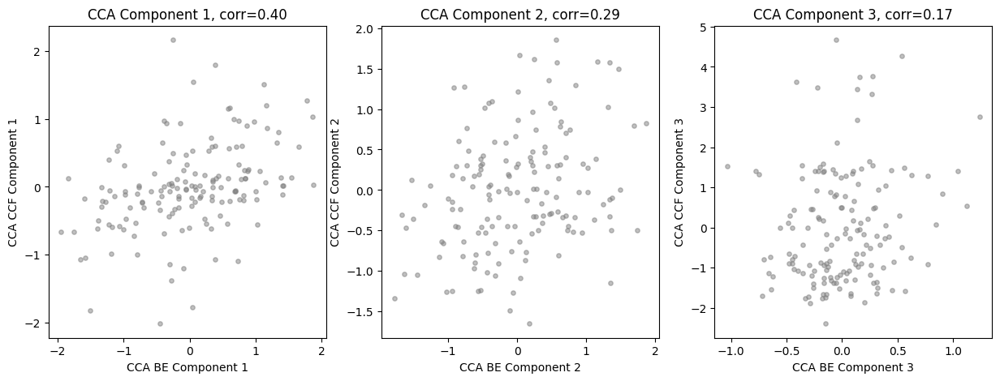

In [218]:
# cca in space
from sklearn.cross_decomposition import CCA
focus_features_cca = focus_features+['be_umap_1', 'be_umap_2']
filter = basic_ephys_df['be_filter'].values & (basic_ephys_df['isi_violations']<=0.2)
cca_be_mat = basic_ephys_df[focus_features_cca].values[filter]
ccf_mat = combined_df[['x_ccf', 'y_ccf', 'z_ccf']].values[filter]
ccf_mat = ccf_mat - bregma_LPS_mm
ccf_mat[:, ml] = -np.abs(ccf_mat[:, ml])  # Mirror ML to left
# remove nan
nan_ind_cca = np.isnan(cca_be_mat).any(axis=1) | np.isnan(ccf_mat).any(axis=1)
cca_be_mat = cca_be_mat[~nan_ind_cca]
ccf_mat = ccf_mat[~nan_ind_cca]
# zscore
cca_be_mat = zscore(cca_be_mat, axis=0, nan_policy='omit')
ccf_mat = zscore(ccf_mat, axis=0, nan_policy='omit')
cca = CCA(n_components=3)
cca_result_be, cca_result_ccf = cca.fit_transform(cca_be_mat, ccf_mat)
# plot cca result
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i in range(3):
    ax = axes[i]
    ax.scatter(cca_result_be[:, i], cca_result_ccf[:, i], c='gray', alpha=0.5, s=15)
    ax.set_xlabel(f'CCA BE Component {i+1}')
    ax.set_ylabel(f'CCA CCF Component {i+1}')
    ax.set_title(f'CCA Component {i+1}, corr={np.corrcoef(cca_result_be[:, i], cca_result_ccf[:, i])[0, 1]:.2f}')
# # print coefficients
# cca_be_coeff = cca.x_weights_
# for i in range(3):
#     print(f'CCA BE Component {i+1} Coefficients:')
#     for j, feature in enumerate(focus_features):
#         print(f'  {feature}: {cca_be_coeff[j, i]:.4f}')
# print cca ccf coeff
cca_ccf_coeff = cca.y_weights_
for i in range(3):
    print(f'CCA CCF Component {i+1} Coefficients:')
    for j, axis in enumerate(['x_ccf', 'y_ccf', 'z_ccf']):
        print(f'  {axis}: {cca_ccf_coeff[j, i]:.4f}')


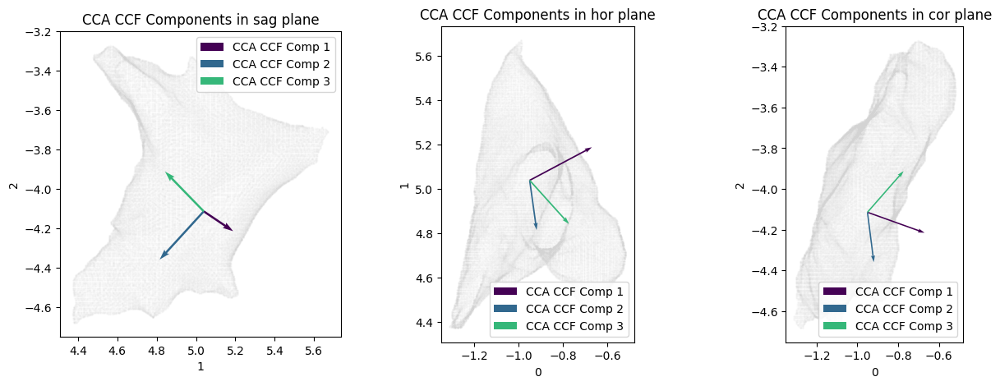

In [219]:
# plot cca ccf components weight in space as vector in ccf space with mesh
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
ccf_mat = combined_df[['x_ccf', 'y_ccf', 'z_ccf']].values[filter]
ccf_mat = ccf_mat - bregma_LPS_mm
ccf_mat[:, ml] = -np.abs(ccf_mat[:, ml])  # Mirror ML to left
for plane_ind, plane in enumerate(planes.keys()):
    ax = axes[plane_ind]
    ax.scatter(mesh_vertices_lps[:, planes[plane][0]], mesh_vertices_lps[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
    for i in range(3):
        vec = cca_ccf_coeff[:, i]
        origin = np.nanmean(ccf_mat, axis=0)
        # origin = np.zeros(3)
        ax.quiver(origin[planes[plane][0]], origin[planes[plane][1]],
                  vec[planes[plane][0]], vec[planes[plane][1]],
                  angles='xy', scale_units='xy', scale=3, label=f'CCA CCF Comp {i+1}', color=cm.viridis(i/3))
    ax.set_xlabel(planes[plane][0])
    ax.set_ylabel(planes[plane][1])
    ax.set_aspect('equal')
    ax.set_title(f'CCA CCF Components in {plane} plane')
    ax.legend()

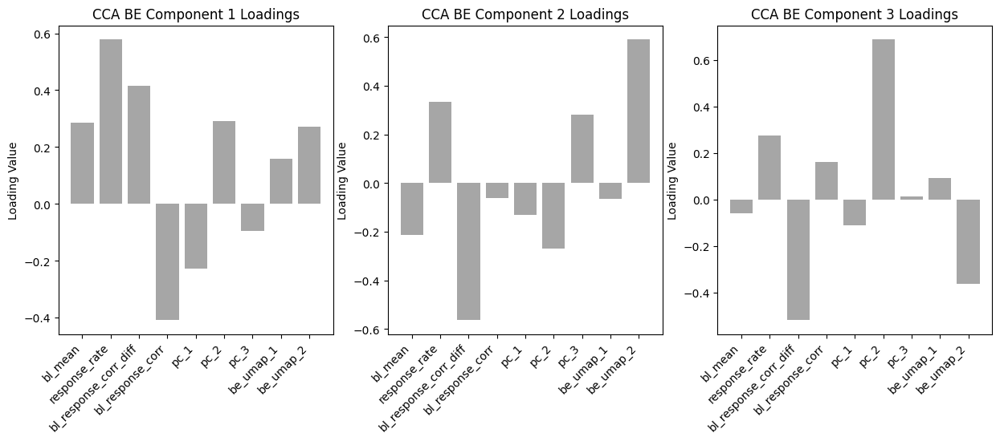

In [220]:
# plot contribution of each feature to cca components as bar plots
cca_be_coeff = cca.x_weights_
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i in range(3):
    ax = axes[i]
    ax.bar(focus_features_cca, cca_be_coeff[:, i], color='gray', alpha=0.7)
    ax.set_title(f'CCA BE Component {i+1} Loadings')
    ax.set_ylabel('Loading Value')
    ax.set_xticklabels(focus_features_cca, rotation=45, ha='right')
    

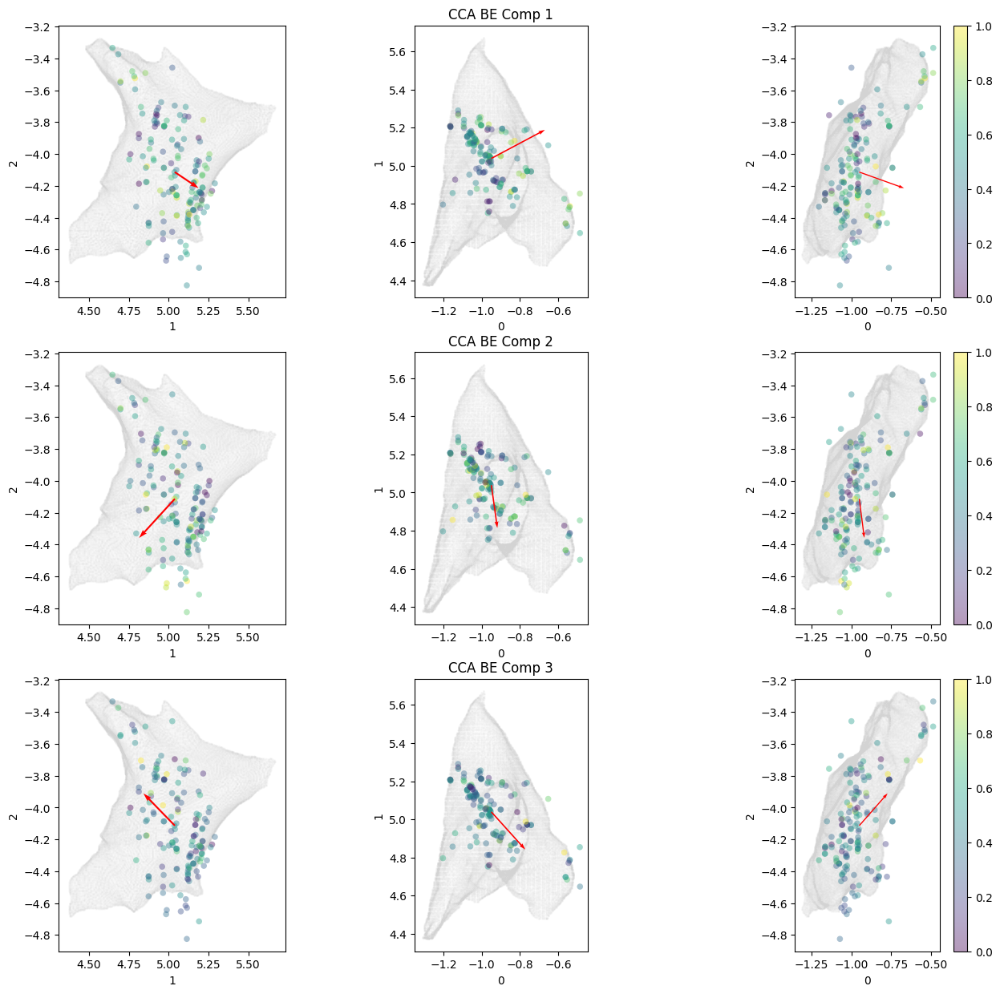

In [221]:
# plot cca be features in ccf space as color code
fig, axes = plt.subplots(3, 3, figsize=(15, 15))
ccfs = combined_df[['x_ccf', 'y_ccf', 'z_ccf']].values[filter][~nan_ind_cca]
ccfs = ccfs - bregma_LPS_mm
ccfs[:, ml] = -np.abs(ccfs[:, ml])  # Mirror ML to left
for dim_ind in range(3):
    cca_values = cca_result_be[:, dim_ind]
    # clip to 2.5-97.5 percentile
    top_90 = np.nanquantile(cca_values, 0.99)
    bottom_10 = np.nanquantile(cca_values, 0.01)
    cca_values_nl = np.clip(cca_values, bottom_10, top_90)
    cca_values_nl = (cca_values_nl - bottom_10) / (top_90 - bottom_10)
    cca_values_nl[np.isnan(cca_values_nl)] = 0.0

    rgba = cmap(cca_values_nl)
    rgb = (rgba[:, :3] * 255).astype(np.uint32)
    colors = (rgb[:, 0] << 16) + (rgb[:, 1] << 8) + rgb[:, 2]

    for j, plane in enumerate(planes.keys()):
        ax = axes[dim_ind, j]
        ax.scatter(mesh_vertices_lps[:, planes[plane][0]], mesh_vertices_lps[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
        sc = ax.scatter(ccfs[:, planes[plane][0]], ccfs[:, planes[plane][1]], c=cca_values_nl, cmap='viridis', s=30, edgecolor='none', alpha=0.4)
        if plane == 'hor':
            ax.set_title(f'CCA BE Comp {dim_ind+1}')
        vec = cca_ccf_coeff[:, dim_ind]
        origin = np.nanmean(ccfs, axis=0)
        # origin = np.zeros(3)
        ax.quiver(origin[planes[plane][0]], origin[planes[plane][1]],
                  vec[planes[plane][0]], vec[planes[plane][1]],
                  angles='xy', scale_units='xy', scale=3, label=f'CCA CCF Comp {dim_ind+1}', color='r')
        ax.set_xlabel(planes[plane][0])
        ax.set_ylabel(planes[plane][1])
        ax.set_aspect('equal')
        if plane == 'cor':
            fig.colorbar(sc, ax=ax, orientation='vertical', fraction=0.05)

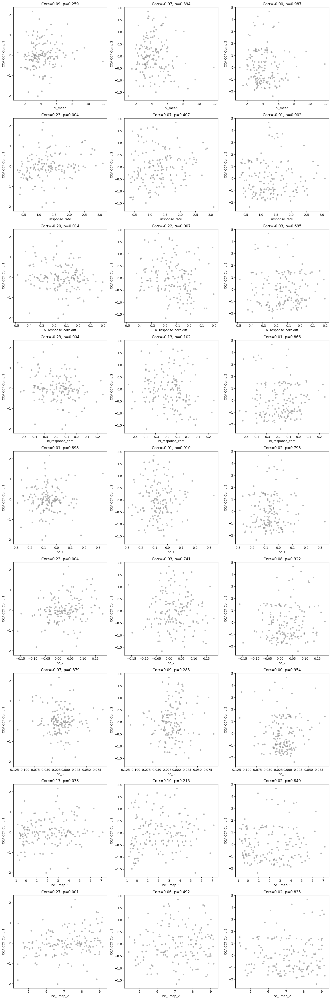

In [223]:
# scatter plot of focus features and cca ccf components with correlation coeffs and p values
fig, axes = plt.subplots(len(focus_features_cca), 3, figsize=(15, 5*len(focus_features_cca)))
for i, feature in enumerate(focus_features_cca):
    feature_values = basic_ephys_df[feature].values[filter][~nan_ind_cca]
    for j in range(3):
        ax = axes[i, j]
        cca_ccf_values = cca_result_ccf[:, j]
        ax.scatter(feature_values, cca_ccf_values, c='gray', alpha=0.5, s=15)
        ax.set_xlabel(feature)
        ax.set_ylabel(f'CCA CCF Comp {j+1}')
        corr_coef = np.corrcoef(feature_values, cca_ccf_values)[0, 1]
        from scipy.stats import pearsonr
        p_value = pearsonr(feature_values, cca_ccf_values)[1]
        ax.set_title(f'Corr={corr_coef:.2f}, p={p_value:.3f}')
plt.tight_layout()

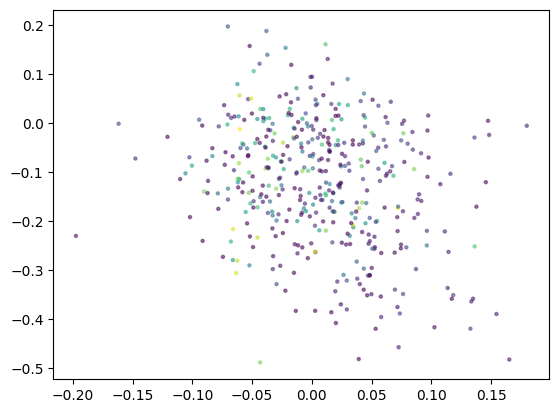

In [ ]:
plt.scatter(basic_ephys_df['pc_2'], basic_ephys_df['bl_response_corr_diff'], c=basic_ephys_df['isi_violations'], alpha=0.5, s=5)

In [225]:
# save results
be_path = os.path.join(beh_folder, f'basic_ephys.pkl')
with open(be_path, 'wb') as f:
    pickle.dump(basic_ephys_df, f)

# load waveform features and plot waveform and basic ephys in pc space

In [226]:
be_path = os.path.join(beh_folder, f'basic_ephys.pkl')
with open(be_path, 'rb') as f:
    basic_ephys_df = pickle.load(f)

In [232]:
waveform_criteria = 'waveform_all'
waveform_type = '_raw'
wf_folder  = os.path.join('/root/capsule/scratch/combined/wf_plots', waveform_criteria, waveform_type)
wf_feature_file = os.path.join(wf_folder, 'wf_features_combined.pkl')
with open(wf_feature_file, 'rb') as f:
    wf_features = pickle.load(f)
wf_features.rename(columns={'unit': 'unit_id'}, inplace=True)

In [233]:
features_be = basic_ephys_df.columns.to_list()
features_be.remove('session')
features_be.remove('unit_id')
features_be.remove('acg')
features_be.remove('acg_bl')
features_be.remove('be_filter')

In [234]:
features_combined = pd.merge(basic_ephys_df, wf_features, on=['session', 'unit_id'], how='left', suffixes=('', '_wf'))
features_combined['combined_filter'] = True
features_combined.loc[basic_ephys_df['be_filter']==False, 'combined_filter'] = False
features_combined = features_combined[features_combined['combined_filter']].copy()

In [235]:
features_combined.columns

Index(['session', 'unit_id', 'bl_mean', 'response_rate', 'response_bias',
       'response_diff', 'bl_diff', 'outcome_diff', 'outcome_diff_abs',
       'bl_response_corr', 'bl_response_corr_sham', 'go_mean', 'no_go_mean',
       'response_lat', 'response_isi', 'bl_response_corr_diff', 'probe', 'acg',
       'acg_bl', 'r2', 'r2_ori', 'sd', 'sd_ori', 'len', 'bl_len', 'acg_1',
       'acg_last', 'sd_log', 'probe_y', 'isi_violations', 'be_filter', 'pc_1',
       'pc_2', 'pc_3', 'burst_ratio', 'burst_bi_dp', 'be_pc_1', 'be_pc_2',
       'be_pc_3', 'be_umap_1', 'be_umap_2', 'amp', 'peak', 'half_w',
       'trough_w', 'pre_half', 'post_half', 'post_w', 'trough_post_ratio_1D',
       'trough_pre_ratio_1D', 'post_slope', 'post_space', 'pre_slope',
       'pre_space', 'symmetry_inte', 'symmetry_half', 'symmetry_slope',
       'symmetry_inte_div', 'symmetry_half_div', 'symmetry_slope_div', 'y_loc',
       'probe_wf', 'score', 'pc1', 'pc2', 'wf', 'cluster', 'gmm_label',
       'gmm_conf', 'kmeans_

In [ ]:
wf_features.columns

Index(['unit', 'session', 'amp', 'peak', 'half_w', 'trough_w', 'pre_half',
       'post_half', 'post_w', 'trough_post_ratio_1D', 'trough_pre_ratio_1D',
       'post_slope', 'post_space', 'pre_slope', 'pre_space', 'symmetry_inte',
       'symmetry_half', 'symmetry_slope', 'symmetry_inte_div',
       'symmetry_half_div', 'symmetry_slope_div', 'y_loc', 'probe', 'score',
       'pc1', 'pc2', 'wf', 'cluster', 'gmm_label', 'gmm_conf', 'kmeans_label',
       'PC1_pre', 'PC2_pre', 'PC3_pre', 'PC1_post', 'PC2_post', 'PC3_post',
       'symmetry_inte_div_log'],
      dtype='object')

In [238]:
# remove those not numeric
features_be = [f for f in features_be if np.issubdtype(basic_ephys_df[f].dtype, np.number)]

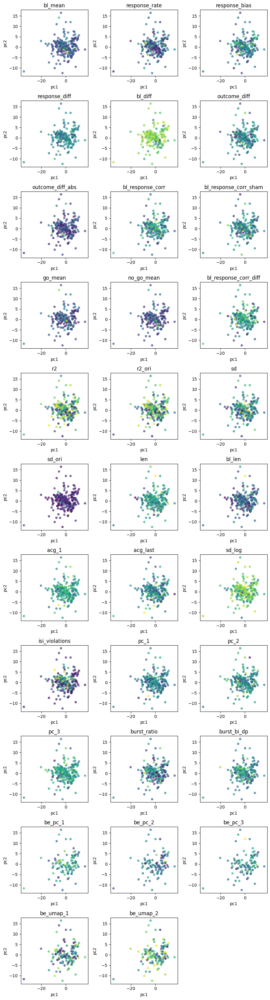

In [239]:
fig = plt.figure(figsize=(9, 3*int(np.ceil(len(features_be)/3))))
gs = gridspec.GridSpec(int(np.ceil(len(features_be)/3)), 3)
filter = feaure
for i, feature in enumerate(features_be):
    ax = fig.add_subplot(gs[i])
    color_code = features_combined[feature].values
    # clip to 5-95 percentile
    top_90 = np.nanquantile(color_code, 0.95)
    bottom_10 = np.nanquantile(color_code, 0.05)
    color_code[color_code > top_90] = top_90
    color_code[color_code < bottom_10] = bottom_10

    ax.scatter(features_combined['pc1'], features_combined['pc2'], c=features_combined[feature], cmap='viridis', s=30, alpha=0.7, edgecolor='none')
    ax.set_title(feature)
    ax.set_xlabel('pc1')
    ax.set_ylabel('pc2')
plt.tight_layout()

In [ ]:
# # histogram of bl features separated by cluster 
# plt.figure(figsize = (9, 3*int(np.ceil(len(features_be)/3))))
# gs = gridspec.GridSpec(int(np.ceil(len(features_be)/3)), 3)
# bin_num = 15
# for i, feature in enumerate(features_be):
#     ax = plt.subplot(gs[i])
#     all_cluster = features_combined[feature].values[filter]
#     cluster1 = features_combined[feature][features_combined['cluster']==0].values
#     cluster2 = features_combined[feature][features_combined['cluster']==1].values
#     edges = np.linspace(np.nanmin(all_cluster), np.nanmax(all_cluster), bin_num)
#     edges[0] = edges[0] - 1e-6  # avoid empty bin at the left edge
#     edges[-1] = edges[-1] + 1e-6  # avoid empty bin at the right edge

#     ax.hist(cluster1, bins=edges, alpha=0.9, color='k', label='C1', density=True, edgecolor='none')
#     ax.hist(cluster2, bins=edges, alpha=0.5, color='gray', label='C2', density=True, edgecolor='none')
#     ax.legend()
#     ax.set_xlabel(feature)
#     ax.set_ylabel('Count')
#     # perform t-test between clusters
#     t_stat, p_value, df = ttest_ind(cluster1[~np.isnan(cluster1)], cluster2[~np.isnan(cluster2)])
#     ax.set_title(label=f'{feature} t {t_stat:.2f} p {p_value:.2f} df {df}')
# plt.tight_layout()


In [ ]:
features_wf = wf_features.columns.to_list()
features_wf.remove('session')
features_wf.remove('unit')
features_wf.remove('wf')
features_wf.remove('gmm_label')
features_wf.remove('kmeans_label')
features_wf.remove('gmm_conf')
features_wf.remove('y_loc')
features_wf.remove('probe')
features_wf.remove('peak')

Compare between ephys features

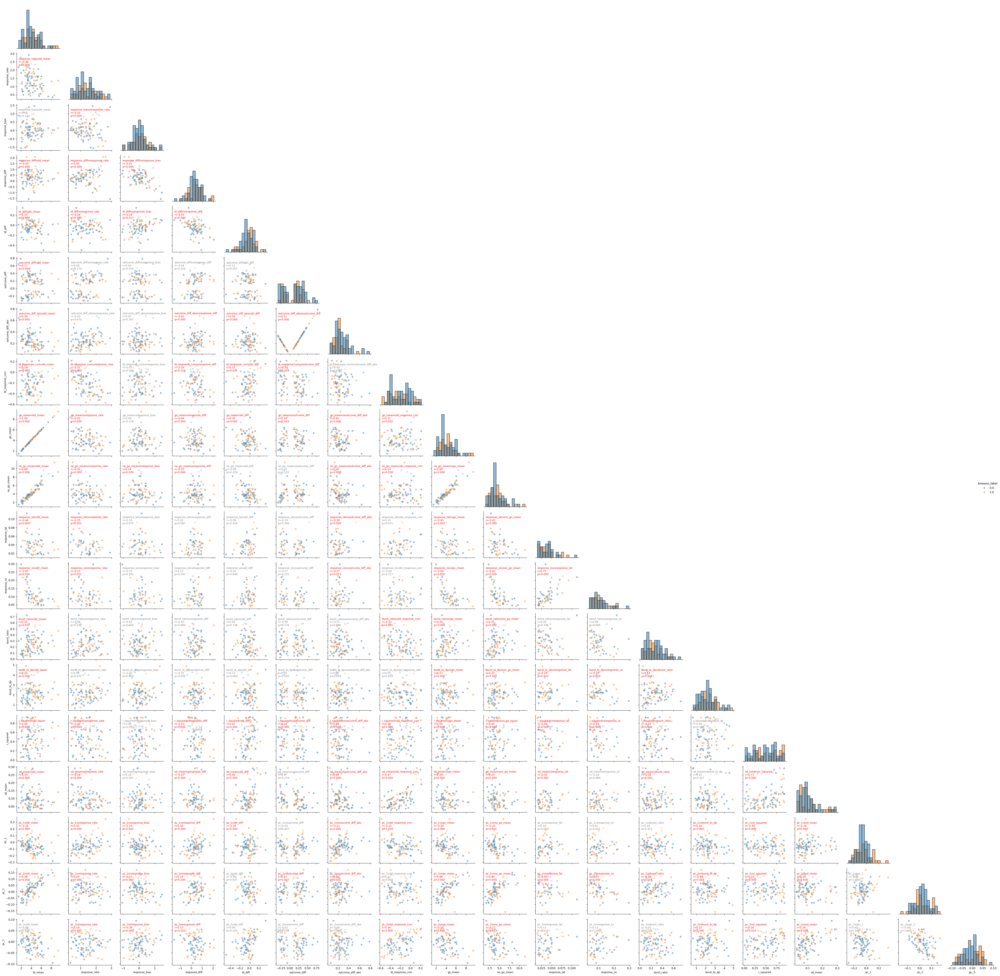

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import pearsonr
import os

selected_features = features_be + features_wf
cluster_name = 'kmeans_label'

selected_features_df = features_combined[selected_features + [cluster_name]].copy()

g = sns.pairplot(
    selected_features_df[features_be + [cluster_name]][filter],
    hue=cluster_name,
    corner=True,
    plot_kws={'s': 40, 'alpha': 0.5},
    diag_kind='hist',
    diag_kws={'bins': 15}
)

# --- Add correlation coefficients (only significant ones in red) ---
for i in range(len(features_be)):
    for j in range(i):
        ax = g.axes[i, j]

        x = selected_features_df[features_be[j]]
        y = selected_features_df[features_be[i]]

        valid = ~(np.isnan(x) | np.isnan(y))
        if np.sum(valid) < 3:
            continue

        r, p = pearsonr(x[valid], y[valid])
        color = 'red' if p < 0.05 else 'gray'

        # Place correlation text in the top-left corner, small and unobtrusive
        ax.text(
            0.05, 0.9, f'{features_be[i]}vs{features_be[j]}\nr={r:.2f}\np={p:.3f}',
            transform=ax.transAxes,
            ha='left', va='top',
            fontsize=9,
            color=color,
            bbox=dict(boxstyle='round,pad=0.2', facecolor='white', alpha=0.5, edgecolor='none')
        )

# --- Add x and y labels to all subplots ---
for i, feature_y in enumerate(features_be):
    for j, feature_x in enumerate(features_be):
        if i == j or j > i:  # Only lower triangle exists when corner=True
            continue
        ax = g.axes[i, j]
        ax.set_xlabel(feature_x, fontsize=9)
        ax.set_ylabel(feature_y, fontsize=9)

# Tight layout for consistent spacing
plt.tight_layout()

# --- Save the figure ---
output_path = os.path.join(beh_folder, f'pairplot_basic_ephys_{criteria_name}.png')
plt.savefig(output_path, bbox_inches='tight', dpi=300)


# Correlation between be and wf

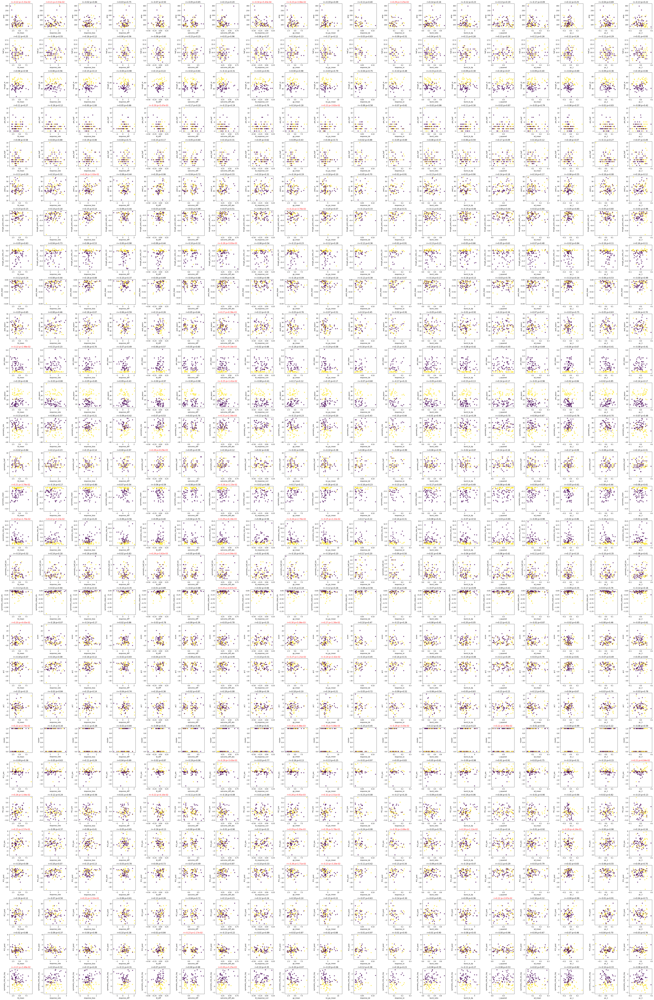

In [ ]:
# compare all values in features_be with features_wf
fig = plt.figure(figsize=(len(features_be) * 3, 3 * len(features_wf)))
gs = gridspec.GridSpec(len(features_wf), len(features_be))
for i, feature in enumerate(features_wf):
    for j, feature_be in enumerate(features_be):
        ax = fig.add_subplot(gs[i, j])
        ax.scatter(features_combined[feature_be][filter], features_combined[feature][filter], c=features_combined['kmeans_label'][filter], cmap='viridis', s=40, alpha=0.7, edgecolor='none')
        
        ax.set_xlabel(feature_be)
        ax.set_ylabel(feature)
        # correlation 
        x = features_combined[feature_be][filter]
        y = features_combined[feature][filter]
        corr, p = stats.pearsonr(x[~np.isnan(x) & ~np.isnan(y)], y[~np.isnan(x) & ~np.isnan(y)])
        ax.set_title(f'r={corr:.2f} p={p:.2f}')
        if p < 0.05:
            ax.set_title(f'r={corr:.2f} p={p:.2e}', color='red')
plt.tight_layout()
plt.savefig(os.path.join(beh_folder, f'feature_correlation_basic_ephys_waveform_{criteria_name}.pdf'), bbox_inches='tight')
plt.savefig(os.path.join(beh_folder, f'feature_correlation_basic_ephys_waveform_{criteria_name}.png'), bbox_inches='tight')


In [ ]:
# features_wf = wf_features.columns.to_list()
# features_wf.remove('session')
# features_wf.remove('unit')
# features_wf.remove('wf')
# features_wf.remove('kmeans_label')
# features_wf.remove('gmm_conf')
# features_wf.remove('y_loc')
# features_wf.remove('probe')
# features_wf.remove('peak')
# features_wf.remove('cluster')
# features_wf.remove('gmm_label')
# features_wf.remove('amp')
# features_wf.remove('pc1')
# features_wf.remove('pc2')
# features_wf.remove('PC3_post')
# features_wf.remove('PC3_pre')
# features_wf.remove('score')

features_wf = ['PC1_post',
                'PC2_post',
                'PC1_pre',
                'PC2_pre',]




In [ ]:
mat_be = features_combined[features_be][filter].values
mat_wf = features_combined[features_wf][filter].values
mat_be = np.asarray(mat_be, dtype=np.float32)
mat_wf = np.asarray(mat_wf, dtype=np.float32)
nan_mask = np.isnan(mat_be).any(axis=1) | np.isnan(mat_wf).any(axis=1)

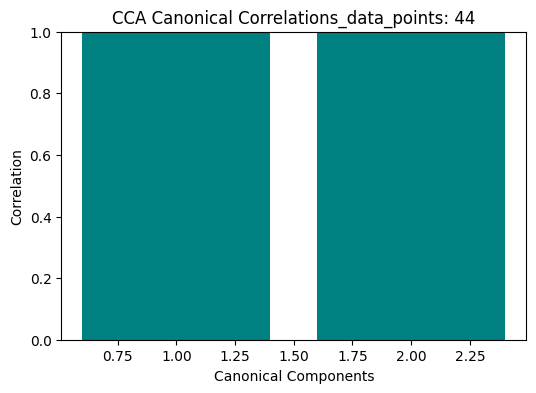

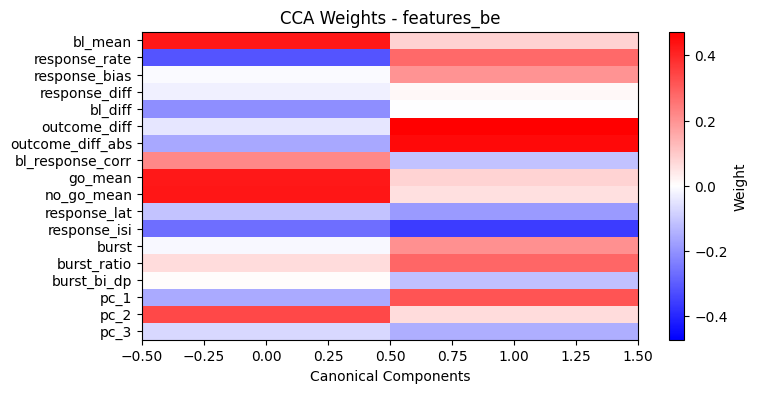

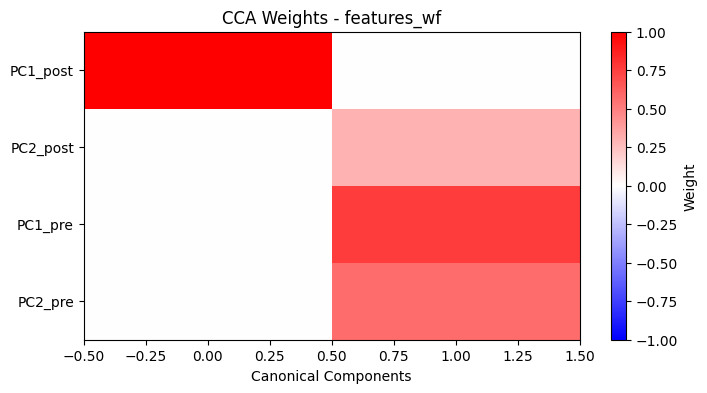

In [ ]:
# Remove rows with any np.nan in mat_be or mat_wf
mat_be_clean = mat_be[~nan_mask]
mat_wf_clean = mat_wf[~nan_mask]
# pca in mat_be_clean
pca_be = PCA(n_components=4)
pca_be.fit(zscore(mat_be_clean, axis=0))
mat_be_clean_pca = pca_be.transform(zscore(mat_be_clean, axis=0))
# any np.nan in mat_be or mat_wf in each row
cca = CCA(n_components=2)
cca.fit(mat_be_clean, mat_be_clean_pca)
X_c, Y_c = cca.transform(mat_be_clean, mat_be_clean_pca)
features_be_pc = [f'PC_{i+1}_be' for i in range(X_c.shape[1])]
# Compute correlations between corresponding canonical variables
corr_values = [np.corrcoef(X_c[:, i], Y_c[:, i])[0, 1] for i in range(2)]

# -------------------------
# ✅ Plot canonical correlations
plt.figure(figsize=(6, 4))
plt.bar(range(1, 3), corr_values, color='teal')
plt.xlabel('Canonical Components')
plt.ylabel('Correlation')
plt.title(f'CCA Canonical Correlations_data_points: {len(mat_be_clean)}')
plt.ylim(0, 1)
plt.show()

# -------------------------
# ✅ Plot CCA Weights for features_be
plt.figure(figsize=(8, 4))
plt.imshow(cca.x_weights_, aspect='auto', cmap='bwr', vmin=-np.max(np.abs(cca.x_weights_)), vmax=np.max(np.abs(cca.x_weights_)))
plt.colorbar(label='Weight')
plt.yticks(range(len(features_be)), features_be)
plt.xlabel('Canonical Components')
plt.title('CCA Weights - features_be')
plt.show()

# -------------------------
# ✅ Plot CCA Weights for features_wf
plt.figure(figsize=(8, 4))
plt.imshow(cca.y_weights_, aspect='auto', cmap='bwr', vmin=-np.max(np.abs(cca.y_weights_)), vmax=np.max(np.abs(cca.y_weights_)))
plt.colorbar(label='Weight')
plt.yticks(range(len(features_wf)), features_wf)
plt.xlabel('Canonical Components')
plt.title('CCA Weights - features_wf')
plt.show()

In [ ]:
# Clean data
mat_be = features_combined[features_be][filter].values
mat_wf = features_combined[features_wf][filter].values

mat_be = np.asarray(mat_be, dtype=np.float32)
mat_wf = np.asarray(mat_wf, dtype=np.float32)

nan_mask = np.isnan(mat_be).any(axis=1) | np.isnan(mat_wf).any(axis=1)

mat_be_clean = mat_be[~nan_mask]
mat_wf_clean = mat_wf[~nan_mask]

# PCA on mat_be_clean
pca_be = PCA(n_components=4)
mat_be_clean_z = zscore(mat_be_clean, axis=0)
pca_be.fit(mat_be_clean_z)
mat_be_clean_pca = pca_be.transform(mat_be_clean_z)

# CCA between mat_be_clean and its PCA projection
cca = CCA(n_components=2)
cca.fit(mat_wf_clean, mat_be_clean_pca)
X_c, Y_c = cca.transform(mat_wf_clean, mat_be_clean_pca)

# Compute correlations between corresponding canonical variables
corr_values = [np.corrcoef(X_c[:, i], Y_c[:, i])[0, 1] for i in range(2)]


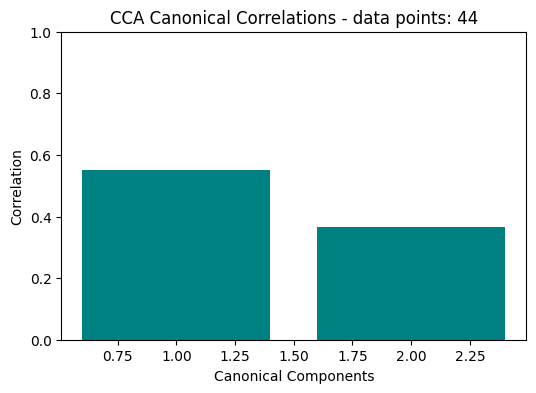

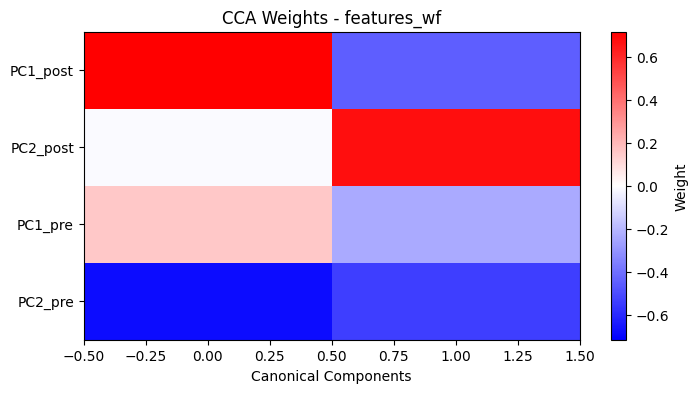

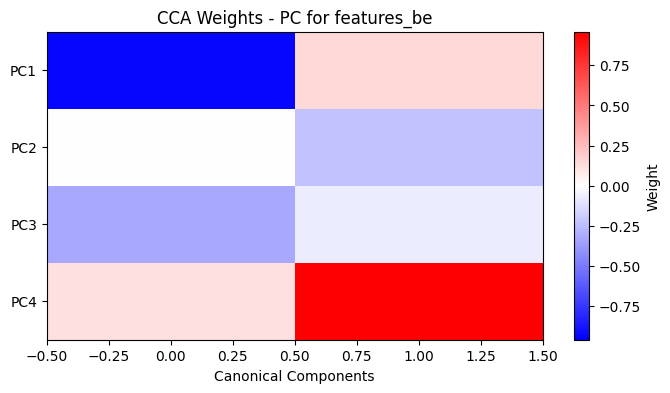

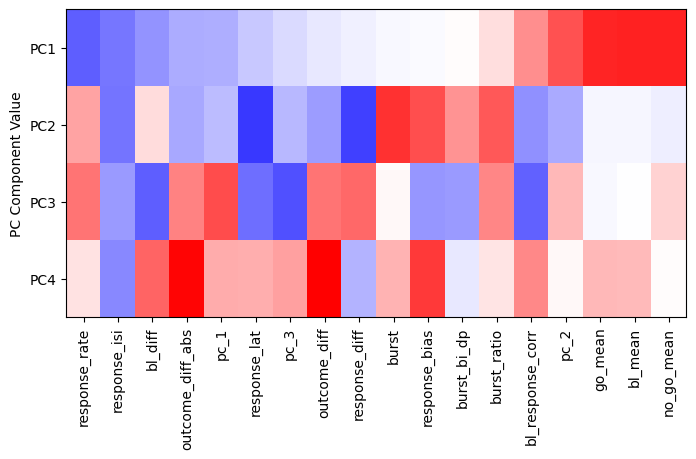

In [ ]:

# -------------------------
# ✅ Plot canonical correlations
plt.figure(figsize=(6, 4))
plt.bar(range(1, 3), corr_values, color='teal')
plt.xlabel('Canonical Components')
plt.ylabel('Correlation')
plt.title(f'CCA Canonical Correlations - data points: {len(mat_be_clean)}')
plt.ylim(0, 1)
plt.show()

# -------------------------
# ✅ Plot CCA Weights for features_be
plt.figure(figsize=(8, 4))
plt.imshow(cca.x_weights_, aspect='auto', cmap='bwr',
           vmin=-np.max(np.abs(cca.x_weights_)), vmax=np.max(np.abs(cca.x_weights_)))
plt.colorbar(label='Weight')
plt.yticks(range(len(features_wf)), features_wf)
plt.xlabel('Canonical Components')
plt.title('CCA Weights - features_wf')
plt.show()

# -------------------------
# ✅ Plot CCA Weights for PCA components
pca_component_labels = [f'PC{i+1}' for i in range(mat_be_clean_pca.shape[1])]

plt.figure(figsize=(8, 4))
plt.imshow(cca.y_weights_, aspect='auto', cmap='bwr',
           vmin=-np.max(np.abs(cca.y_weights_)), vmax=np.max(np.abs(cca.y_weights_)))
plt.colorbar(label='Weight')
plt.yticks(range(len(pca_component_labels)), pca_component_labels)
plt.xlabel('Canonical Components')
plt.title('CCA Weights - PC for features_be')
plt.show()

# plot pc component of mat_be_clean_pca
plt.figure(figsize=(8, 4))
sort_ind = np.argsort(pca_be.components_[0])
plt.imshow(pca_be.components_[:, sort_ind], aspect='auto', cmap='bwr',
              vmin=-np.max(np.abs(pca_be.components_)), vmax=np.max(np.abs(pca_be.components_)))

plt.ylabel('PC Component Value')
plt.yticks(range(len(pca_component_labels)), pca_component_labels);
plt.xticks(np.arange(len(features_be)), np.array(features_be)[sort_ind], rotation=90);

